음악 구조를 분석하기 위한 기술적 도구인 자기 유사성 행렬(self similarity matrix)의 개념에 대해 상세히 다루고, 그 구조적 속성에 대해 논의한다.

> 이 글은 [FMP(Fundamentals of Music Processing) Notebooks](https://www.audiolabs-erlangen.de/resources/MIR/FMP/C0/C0.html)을 참고로 합니다.

In [1]:
import numpy as np
import scipy
from scipy import signal
from matplotlib import pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import ListedColormap
import IPython.display as ipd
import pandas as pd
import librosa, librosa.display

from utils.feature_tools import normalize_feature_sequence, smooth_downsample_feature_sequence, median_downsample_feature_sequence
from utils.plot_tools import plot_matrix, compressed_gray_cmap, plot_chromagram, plot_segments
import utils.tempo_tools as tmpo
from utils.structure_tools import read_structure_annotation, convert_structure_annotation

# 자기 유사성 행렬 (Self Similarity Matrix, SSM)

## 기본 정의

- $\mathcal{F}$를 특징(feature) 공간이라고 하고 $s:\mathcal{F}\times\mathcal{F}\to \mathbb{R}$를 두 요소 $x,y\in\mathcal{F}$를 비교할 수 있는 유사성(similarity) 척도라고 하자. 일반적으로 $s(x,y)$ 값은 요소 $x,y\in\mathcal{F}$가 비슷하면 높고 그렇지 않으면 작다. 
- 특징 시퀀스 $X=(x_1,x_2,\ldots,x_N)$가 주어지면 시퀀스의 모든 요소를 서로 비교할 수 있다. 
- 결과적으로 $N$-square **자기 유사성 행렬**(self-similarity matrix) $\mathbf{S}\in\mathbb{R}^{N\times N}$이 아래와 같이 정의된다.

$$\mathbf{S}(n,m):=s(x_n,x_m),$$
where $x_n,x_m\in\mathcal{F}$ for $n,m\in[1:N]$
    
- 다음에서 $(n,m)\in[1:N]\times[1:N]$ 튜플은 $\mathbf{S}$의 **셀**(cell)이라고도 하며 값 $\mathbf{S}(n,m)$는 셀 $(n,m)$의 **점수**(score)라고 한다. 

- 응용의 맥락 및 데이터를 비교하는 데 사용되는 개념에 따라 **반복 플롯(recurrence plot)**, **비용 매트릭스(cost matrix)** 또는 **자기-거리 매트릭스(self-distance matrix)** 와 같은 다른 이름으로 알려진 관련된 개념이 많다.

- 종종 특징 공간이 차원 $K\in\mathbb{N}$의 유클리드 공간 $\mathcal{F}=\mathbb{R}^K$라고 가정한다. 간단한 유사성 측정 $s$는 예를 들어 다음과 같이 정의된 내적이다.

$$s(x,y) := \langle x,y\rangle$$
for two vectors $x,y\in\mathcal{F}$
 
- 이 유사성 측정을 사용하면 직교(orthogonal)하는 두 특징(feature) 벡터 사이의 점수는 0이고, 그렇지 않으면 0이 아니다. 특징 벡터가 유클리드 노름(norm)에 대해 **정규화**되는 경우, 유사성 값 $s(x,y)$는 $[-1,1]$ 구간에 있다. 이 경우 정규화된 피쳐의 시퀀스 $X=x_1,x_2,\ldots,x_N)$가 주어지면, $s(x_n,x_n)=1$ for all $n\in[1:N]$인 경우 SSM의 최대값이 가정된다. 따라서 결과 SSM에는 값이 큰 대각선이 있다. 더 일반적으로 말하면, 주어진 특징 시퀀스의 반복 패턴은 유사성 값이 큰 구조의 형태로 SSM에서 볼 수 있다.

- 다음 예에서는 정규화된(normalized) 특징 벡터의 합성(synthetic) 특징 시퀀스를 생성한다. 특징 벡터의 차원은 $K=4$이고 시퀀스의 길이는 $N=500$이다. 그림은 특징 시퀀스와 결과 SSM을 보여준다.

- **중요 사항:**
    - SSM을 시각화할 때 컬러맵 'cmap'의 선택은 그림의 전체적인 모습에 상당한 영향을 미칠 수 있다. 적합한 컬러맵을 선택하면 SSM의 특정 속성을 시각적으로 강조하는 데 도움이 될 수 있다.
    - 위에서 설명한 정규화된 특징의 특징 시퀀스와 유사도 측정을 사용하면 간단한 행렬-행렬 곱으로 SSM을 계산할 수 있다. 보다 정확하게는 $K\times N$-matrix $X$에 의해 특성 시퀀스가 구현되는 경우, SSM $S$는 $S=X^\top X$로 주어진다.
<!--<br>`S = np.dot(np.transpose(X),X)`.-->
    * 또한, 특징 벡터의 모든 항목이 양수라고 종종 가정한다. 이 경우 $s(x_n,x_m)$ 값은 양수이며 $[0,1]$ 간격에 있다.

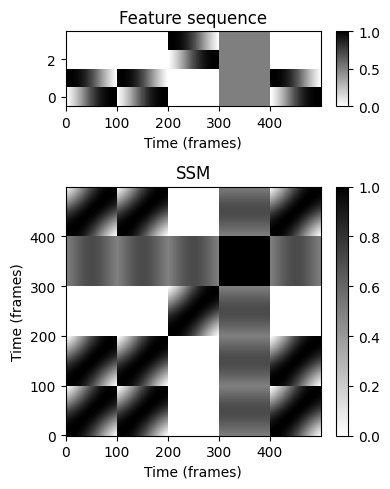

In [2]:
# Generate normalized feature sequence
K = 4
M = 100
r = np.arange(M)
b1 = np.zeros((K,M))
b1[0,:] = r
b1[1,:] = M-r
b2 = np.ones((K,M))
X = np.concatenate(( b1, b1, np.roll(b1, 2, axis=0), b2, b1 ), axis=1)
X_norm = normalize_feature_sequence(X, norm='2', threshold=0.001)

# Compute SSM
S = np.dot(np.transpose(X_norm), X_norm)

# Visualization
cmap = 'gray_r'
fig, ax = plt.subplots(2, 2, gridspec_kw={'width_ratios': [1, 0.05], 
                                          'height_ratios': [0.3, 1]}, figsize=(4, 5))
plot_matrix(X_norm, Fs=1, ax=[ax[0,0], ax[0,1]], cmap=cmap,
            xlabel='Time (frames)', ylabel='', title='Feature sequence')
plot_matrix(S, Fs=1, ax=[ax[1,0], ax[1,1]], cmap=cmap,
            title='SSM', xlabel='Time (frames)', ylabel='Time (frames)', colorbar=True);
plt.tight_layout()

- 컬러맵을 적절하게 조정하여 시각적 모양을 변경할 수 있다. 예를 들어 색상 분포를 더 밝은 색상으로 이동하면 시각화의 경로 구조가 향상된다.

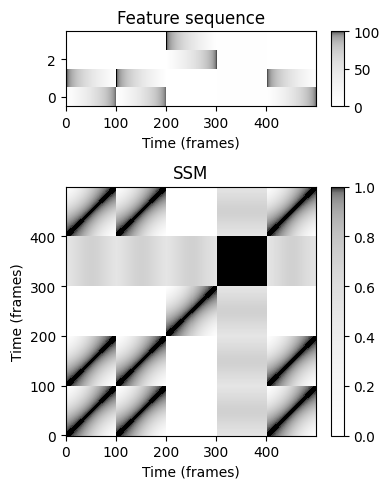

In [3]:
cmap = compressed_gray_cmap(alpha=-1000)
fig, ax = plt.subplots(2, 2, gridspec_kw={'width_ratios': [1, 0.05], 
                                          'height_ratios': [0.3, 1]}, figsize=(4,5))
plot_matrix(X, Fs=1, ax=[ax[0,0], ax[0,1]], cmap=cmap,
            xlabel='Time (frames)', ylabel='', title='Feature sequence')
plot_matrix(S, Fs=1, ax=[ax[1,0], ax[1,1]], cmap=cmap,
            title='SSM', xlabel='Time (frames)', ylabel='Time (frames)', colorbar=True);
plt.tight_layout()

## 블록과 경로구조 (Block and Path Structures)

- SSM에서 가장 눈에 띄는 두 가지 구조는 이미 앞의 예에서 볼 수 있듯이 **블록(block)** 및 **경로(paths)** 라고 한다. 

- 특징 시퀀스가 전체 음악의 지속 기간(duration) 동안 다소 일정하게 유지되는 음악 속성을 캡처하는 경우, 각 특징 벡터는 이 세그먼트 내의 다른 모든 특징 벡터와 유사함을 의미한다. 결과적으로 큰 값의 전체 **블록**이 SSM에 나타난다. 
    - 즉, **동질성(homogeneity) 속성은 블록 같은(block-like) 구조**에 해당한다. 

- 특징 시퀀스가 2개의 반복 하위시퀀스(예를 들어, 동일한 멜로디에 대응하는 2개의 세그먼트)를 포함하는 경우, 두 하위시퀀스의 대응하는 요소는 서로 유사하다. 결과적으로 주 대각선과 평행하게 실행되는 유사성이 높은 **경로**(또는 **스트라이프(stripe)**)가 SSM에 표시된다. 
    - 즉, **반복(repetitive) 속성은 경로 같은(path-like) 구조**에 해당한다.

- 예로, 다음 그림은 음악적 구조가 $A_1A_2B_1B_2CA_3B_3B_4D$인 Brahms의 헝가리 무곡 5번에 대한 이상적인 SSM을 보여준다. 세 개의 반복되는 $A$ 부분 세그먼트가 동종이라고 가정하면 SSM에는 $A_1A_2$에 해당하는 세그먼트를 자신과 관련시키는 2차 블록과 $A_3$ 부분 세그먼트를 자신과 관련시키는 또 다른 2차 블록이 있다. 또한 두 개의 직사각형 블록이 있는데, 하나는 $A_1A_2$ 부분 세그먼트를 $A_3$ 부분 세그먼트에 연결하고 다른 하나는 $A_3$ 부분 세그먼트를 $A_1A_2$ 부분 세그먼트에 연결한다. 3개의 반복되는 $A$ 부분 세그먼트가 동질적이지 않은 경우 SSM은 주 대각선에 평행하게 실행되는 경로 구조를 나타낸다. 예를 들어 $A_1$와 $A_2$의 유사도가 큰 경로와 $A_1$와 $A_3$의 경로가 있다.

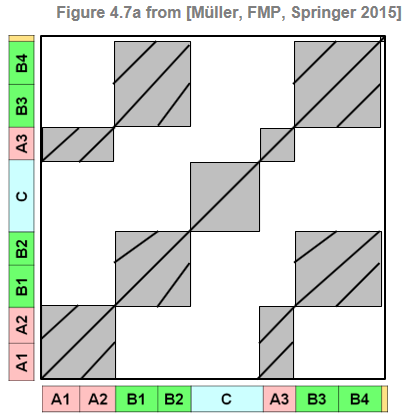

In [4]:
ipd.Image("../img/5.music_structure_analysis/FMP_C4_F07a.png", width=300)

## 크로마그램 기반 SSM 

- 다음 코드는 **크로마그램(chromagram)** 을 특징 표현으로 사용하여 Brahms의 헝가리 댄스 녹음에서 SSM을 생성한다. 시각화에서 $\mathbf{S}$의 큰 값은 어두운 회색으로 표시되고 작은 값은 밝은 회색으로 표시된다. 
- 실제로 이 경우 얻은 SSM은 이상적인 SSM과 상당 부분 유사하다. $A$ 부분 세그먼트에 해당하는 block-like 구조는 이러한 세그먼트가 화음과 관련하여 상당히 동질적임을 나타낸다. $C$ 부분 세그먼트도 마찬가지다. 또한, $C$ 부분 블록 외부의 작은 유사성 값(즉, $C$ 부분 프레임을 다른 세그먼트의 프레임에 연결하는 모든 셀)은 $C$ 부분 세그먼트가 화성적으로 모든 부분과 거의 관련이 없음을 보여준다. $B$ 부분 세그먼트의 경우 path-like 구조가 있고 block-like 구조는 없다. 이는 $B$ 파트 세그먼트가 동일한 화성 진행(즉, 화성에 대한 반복)을 공유하지만 화성에 대해 동질적이지 않음을 보여준다.
- 흥미로운 점은 반복하더라도 $B$ 부분 세그먼트가 다른 템포로 재생되므로 길이가 다르다는 것이다. 예를 들어 짧은 $B_2$ 섹션은 $B_1$ 섹션보다 빠르게 재생된다. 결과적으로 해당 경로는 정확히 병렬로 실행되지 않는다.

In [5]:
def compute_sm_dot(X, Y):
    """Computes similarty matrix from feature sequences using dot (inner) product

    Args:
        X (np.ndarray): First sequence
        Y (np.ndarray): Second Sequence

    Returns:
        S (float): Dot product
    """
    S = np.dot(np.transpose(X), Y)
    return S

In [6]:
def plot_feature_ssm(X, Fs_X, S, Fs_S, ann, duration, color_ann=None,
                     title='', label='Time (seconds)', time=True,
                     figsize=(5, 6), fontsize=10, clim_X=None, clim=None):
    """Plot SSM along with feature representation and annotations (standard setting is time in seconds)

    Args:
        X: Feature representation
        Fs_X: Feature rate of ``X``
        S: Similarity matrix (SM)
        Fs_S: Feature rate of ``S``
        ann: Annotaions
        duration: Duration
        color_ann: Color annotations (see :func:`libfmp.b.b_plot.plot_segments`) (Default value = None)
        title: Figure title (Default value = '')
        label: Label for time axes (Default value = 'Time (seconds)')
        time: Display time axis ticks or not (Default value = True)
        figsize: Figure size (Default value = (5, 6))
        fontsize: Font size (Default value = 10)
        clim_X: Color limits for matrix X (Default value = None)
        clim: Color limits for matrix ``S`` (Default value = None)

    Returns:
        fig: Handle for figure
        ax: Handle for axes
    """
    cmap = compressed_gray_cmap(alpha=-10)
    fig, ax = plt.subplots(3, 3, gridspec_kw={'width_ratios': [0.1, 1, 0.05],
                                              'wspace': 0.2,
                                              'height_ratios': [0.3, 1, 0.1]},
                           figsize=figsize)
    plot_matrix(X, Fs=Fs_X, ax=[ax[0, 1], ax[0, 2]], clim=clim_X,
                         xlabel='', ylabel='', title=title)
    ax[0, 0].axis('off')
    plot_matrix(S, Fs=Fs_S, ax=[ax[1, 1], ax[1, 2]], cmap=cmap, clim=clim,
                         title='', xlabel='', ylabel='', colorbar=True)
    ax[1, 1].set_xticks([])
    ax[1, 1].set_yticks([])
    plot_segments(ann, ax=ax[2, 1], time_axis=time, fontsize=fontsize,
                           colors=color_ann,
                           time_label=label, time_max=duration*Fs_X)
    ax[2, 2].axis('off')
    ax[2, 0].axis('off')
    plot_segments(ann, ax=ax[1, 0], time_axis=time, fontsize=fontsize,
                           direction='vertical', colors=color_ann,
                           time_label=label, time_max=duration*Fs_X)
    return fig, ax

In [7]:
fn_wav = '../data_FMP/FMP_C4_Audio_Brahms_HungarianDances-05_Ormandy.wav'
x, Fs = librosa.load(fn_wav)
ipd.Audio(x,rate=Fs)

In [8]:
x_duration = (x.shape[0])/Fs

# Chroma Feature Sequence
N, H = 4096, 1024
chromagram = librosa.feature.chroma_stft(y=x, sr=Fs, tuning=0, norm=2, hop_length=H, n_fft=N)
X, Fs_X = smooth_downsample_feature_sequence(chromagram, Fs/H, filt_len=41, down_sampling=10) #smoothed

# Annotation
fn_ann = '../data_FMP/FMP_C4_Audio_Brahms_HungarianDances-05_Ormandy.csv'
ann, color_ann = read_structure_annotation(fn_ann)
ann_frames = convert_structure_annotation(ann, Fs=Fs_X) 

# SSM 
X = normalize_feature_sequence(X, norm='2', threshold=0.001)
S = compute_sm_dot(X,X)

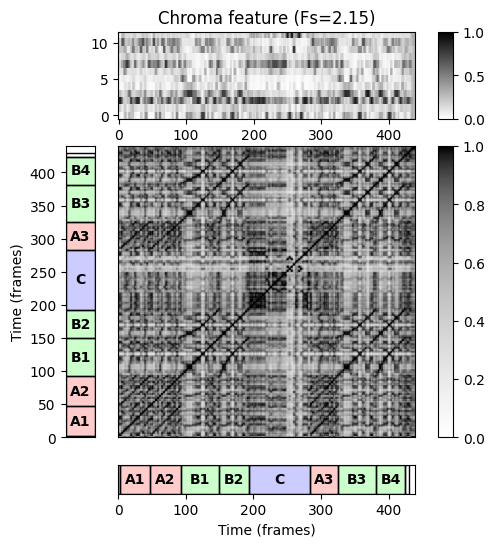

In [9]:
fig, ax = plot_feature_ssm(X, 1, S, 1, ann_frames, x_duration*Fs_X, color_ann=color_ann,
                           clim_X=[0,1], clim=[0,1], label='Time (frames)',
                           title='Chroma feature (Fs=%0.2f)'%Fs_X)

## MFCC 기반 SSM

- 다음으로 **MFCC 특징**을 기반으로 SSM을 계산해본다. 이 표현의 모든 $K(=20)$개의 MFCC 계수를 사용하면 주로 block-like 구조를 가지는 SSM이 생성된다. 특히 $A$ 부분과 $C$ 부분에 대략적으로 대응하는 블록을 관찰할 수 있다. 실제로 블록 구조는 MFCC 특징의 처음 두 개(낮은) 계수에 의해 지배된다. 계수 $4$ ~ $14$만 고려하면 더 미세한 블록 구조를 갖고 경로와 같은 구조를 나타내는 SSM이 생성된다.

- **중요 사항:**
    * SSM을 계산하기 전에, **다운샘플링**과 함께 평균화 필터를 적용하여 **스무딩**을 적용한다. 스무딩은 피처 시퀀스의 작은 로컬 변동을 억제하고 결과 SSM에 상당한 영향을 미칠 수 있다.
    * 특징 시퀀스를 $H$만큼 다운샘플링하면 SSM $\mathbf{S}$를 계산할 때 $H^2$만큼 효율성이 증가한다.
    * MFCC 특징의 값이 음수일 수 있으므로 SSM 값도 음수일 수 있다(MFCC 기능을 정규화한 후 $[1,-1]$ 구간에서).

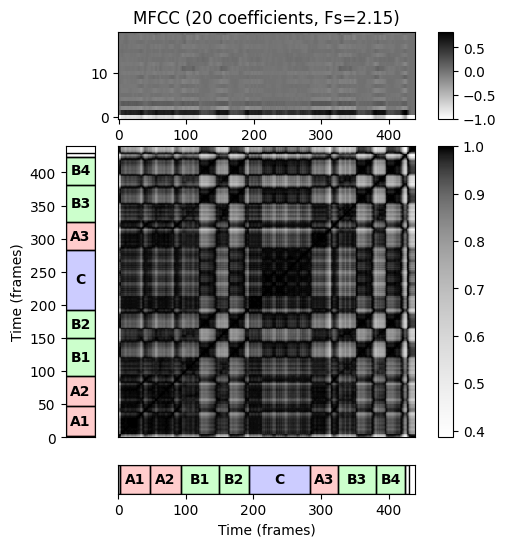

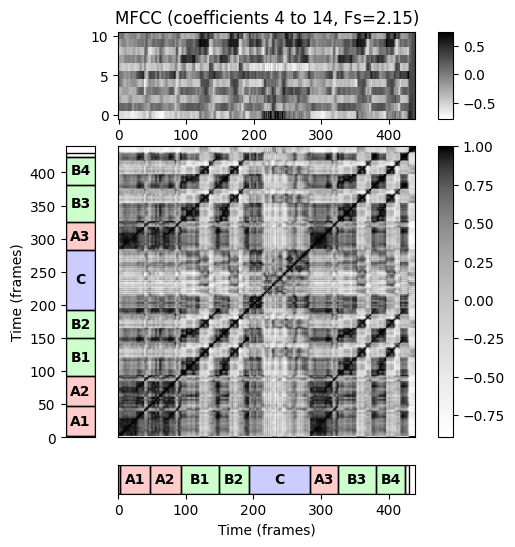

In [10]:
# MFCC-based feature sequence
N, H = 2048, 1024
X_MFCC = librosa.feature.mfcc(y=x, sr=Fs, hop_length=H, n_fft=N)

coef = np.arange(0,20)
X_MFCC_upper = X_MFCC[coef,:]
X, Fs_X = smooth_downsample_feature_sequence(X_MFCC_upper, Fs/H, filt_len=41, down_sampling=10)
X = normalize_feature_sequence(X, norm='2', threshold=0.001)
S = compute_sm_dot(X,X)

fig, ax = plot_feature_ssm(X, 1, S, 1, ann_frames, x_duration*Fs_X, color_ann=color_ann,
    title='MFCC (20 coefficients, Fs=%0.2f)'%Fs_X, label='Time (frames)')


# MFCC-based feature sequence only using coefficients 4 to 14
coef = np.arange(4,15)
X_MFCC_upper = X_MFCC[coef,:]
X, Fs_X = smooth_downsample_feature_sequence(X_MFCC_upper, Fs/H, filt_len=41, down_sampling=10)
X = normalize_feature_sequence(X, norm='2', threshold=0.001)
S = compute_sm_dot(X,X)
fig, ax = plot_feature_ssm(X, 1, S, 1, ann_frames, x_duration*Fs_X, 
                           color_ann=color_ann, label='Time (frames)',
                           title='MFCC (coefficients 4 to 14, Fs=%0.2f)'%Fs_X)


## 템포그램 기반 SSM

- 마지막으로 **순환 푸리에 템포그램(cyclic Fourier tempogram)** 을 기본 특징(feature) 표현으로 사용하여 SSM을 계산한다. 크로마 기반의 SSM에 비해 템포그램 기반의 SSM은 구조가 명확하지 않다. 
- 적어도 $C$ 부분 세그먼트에 해당하는 블록을 관찰할 수 있으므로 대조되는 역할을 강조한다. 또한 SSM은 음악 녹음에서 발생하는 많은 템포 변화를 나타낸다.

In [11]:
# Tempogram feature sequence
nov, Fs_nov = tmpo.compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, gamma=100, M=10, norm=True)
nov, Fs_nov = tmpo.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)


N, H = 1000, 100
X, T_coef, F_coef_BPM = tmpo.compute_tempogram_fourier(nov, Fs_nov, N=N, H=H, Theta=np.arange(30, 601))
octave_bin = 12
tempogram_F = np.abs(X)
output = tmpo.compute_cyclic_tempogram(tempogram_F, F_coef_BPM, octave_bin=octave_bin)
X = output[0]
F_coef_scale = output[1]
Fs_X = Fs_nov/H
X = normalize_feature_sequence(X, norm='2', threshold=0.001)
S = compute_sm_dot(X,X)

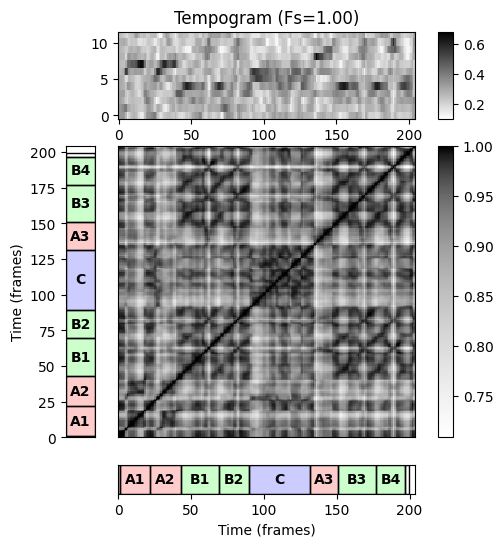

In [12]:
ann_frames = convert_structure_annotation(ann, Fs=Fs_X)

fig, ax = plot_feature_ssm(X, 1, S, 1, ann_frames, x_duration*Fs_X, color_ann=color_ann,
    title='Tempogram (Fs=%0.2f)'%Fs_X, label='Time (frames)')

## 경로와 블록의 정의

- **세그먼트**(**segment**)를 시작점 $s$와 끝점 $t$로 지정된 집합 $\alpha=[s:t]\subseteq [1:N]$로 정의한다. (특징 인덱스로 주어짐).

- $|\alpha|:=t-s+1$가 $\alpha$의 길이를 나타낸다고 하자. 

- 다음으로, 길이 $L$의 $\alpha$ 의 **경로**(**path**)는 다음의 시퀀스와 같다.
$$P=((n_1,m_1), \ldots,(n_L,m_L))$$
    - $(n_\ell,m_\ell)\in[1:N]^2$,  $\ell\in[1:L]$
    - $m_1=s$ 및 $m_L=t$를 만족 (**boundary condition**) 
    - $(n_{\ell+1},m_{\ell+1}) -(n_\ell,m_\ell)\in \Sigma$ (**step size condition**), 여기서 $\Sigma$는 허용 가능한 step size 집합을 나타냄

- 이 정의는 워핑 경로(warping path)의 정의와 비슷하다. $\Sigma = \{(1,1)\}$의 경우, 경로는 "strictly diagonal"하다.

- 다음에서 집합 $\Sigma = \{(2,1),(1,2),(1,1)\}$을 사용한다. 경로 $P$에 대해, 각각 $\pi_1(P):=[n_1:n_L]$와 $\pi_2(P):=[m_1:m_L]$ 투영(projection)으로 정의된 두 세그먼트를 연결할 수 있다.

- 경계 조건에 따라 $\pi_2(P)=\alpha$이 적용된다. 다른 세그먼트 $\pi_1(P)$는 **유도된(induced) 세그먼트**라고 한다. 

- $P$의 **점수** $\sigma(P)$는 다음과 같이 정의된다.
$$\sigma(P) := \sum_{\ell=1}^L \mathbf{S}(n_\ell,m_\ell)$$
    
- $\alpha$ 세그먼트의 각 경로는 $\alpha$와 유도된 세그먼트 사이의 관계를 인코딩하며, 이 때 $\sigma(P)$ 점수는 이 관계에 대한 퀄리티 척도(quality measure)를 산출한다.

- 세그먼트 $\alpha=[s:t]$ 위의 **블록**은 다음의 하위 집합이다..
$$B=\alpha' \times \alpha \subseteq [1:N]\times [1:N]$$
for some segment $\alpha'=[s':t']$
    
- 경로와 마찬가지로 블록 $B$에 대한 두 개의 투영 $\pi_1(B)=\alpha'$ 및 $\pi_2(B)=\alpha$를 정의하고 $\alpha'$를 **유도된 세그먼트**라고 부른다.

- 또한 블록 $B$의 점수를 다음과 같이 정의한다.
    - $\sigma(B)=\sum_{(n,m)\in B}\mathbf{S}(n,m)$

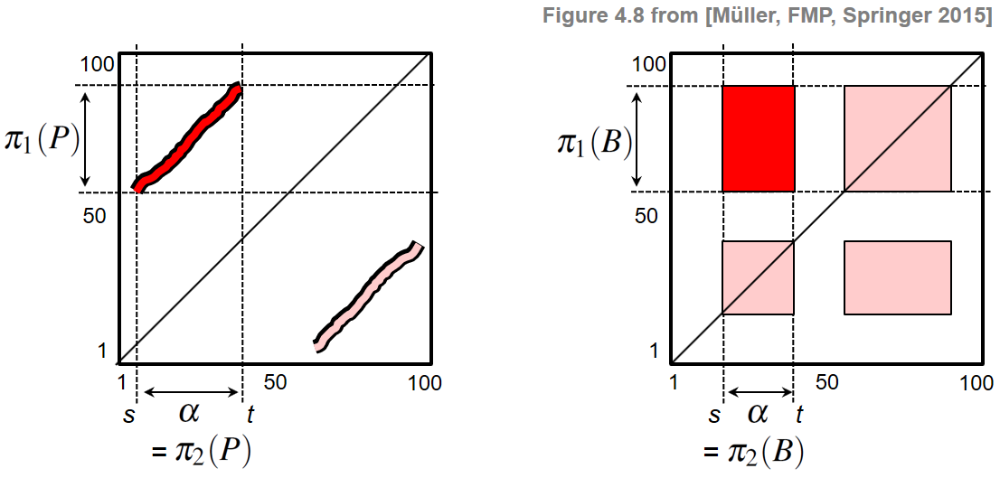

In [13]:
ipd.Image("../img/5.music_structure_analysis/FMP_C4_F08.png", width=600)

- 경로와 블록을 기반으로 세그먼트 간의 서로 다른 종류의 유사 관계를 고려할 수 있다. 
    - $\pi_1(P)=\alpha_1$ 및 $\pi_2(P)=\alpha_2$의 높은 점수의 경로 $P$가 있는 경우, $\alpha_1$ 세그먼트는 $\alpha_2$ 세그먼트와 **경로 유사(path-similar)** 하다고 한다.
    - $\pi_1(B)=\alpha_1$ 및 $\pi_2(B)=\alpha_2$의 높은 점수의 블록 $B$가 있는 경우, $\alpha_1$는 $\alpha_2$와 **블록 유사(block-similar)** 하다.

- 유사성 측정 $s$가 대칭인 경우, 자기 유사성 행렬 $\mathbf{S}$와 위에서 정의한 세그먼트 간의 유사성 관계도 대칭적이다. 

- 유사성 관계의 또 다른 중요한 속성은 **전이성**(**transitivity**)이다. 즉 $\alpha_1$ 세그먼트가 $\alpha_2$ 세그먼트와 유사하고 $\alpha_2$ 세그먼트가 $\alpha_3$ 세그먼트와 유사하면 $\alpha_1$도 $\alpha_3$와 유사해야 한다. 
- 또한 유사성 척도 $s$에 전이성이 있는 경우 경로 및 블록 유사성에 대해서도 전이성은 유지된다. 결과적으로 경로 및 블록 구조는 (적어도 이상적인 경우에는) 특정 대칭 및 전이 속성을 충족하는 그룹으로 나타나는 경우가 많다.

- 음악 구조 분석에 대한 대부분의 계산적 접근은 SSM의 경로- 및 블록-like 구조를 어떤 식으로든 활용하며, 전체 알고리즘 파이프라인에는 일반적으로 다음과 같은 일반적인 단계가 포함된다.
    * 음악 신호는 적절한 특징 시퀀스(feature sequence)로 변환된다.
    * 자기 유사성 행렬(SSM)은 유사성 측정을 기반으로 특징 시퀀스에서 계산된다.
    * 전체 점수가 높은 블록과 경로는 SSM에서 구해진다. 각 블록 또는 경로는 유사한 세그먼트 쌍을 정의한다.
    * 상호 유사한 세그먼트의 전체 그룹은 클러스터링 단계를 적용하여 쌍별(pairwise) 관계에서 형성된다.

- 마지막 단계는 블록 및 경로 구조에 의해 유도된 쌍별 세그먼트 관계의 일종의 전이적 폐쇄(transitive closure)를 형성하는 것으로 간주할 수 있다.

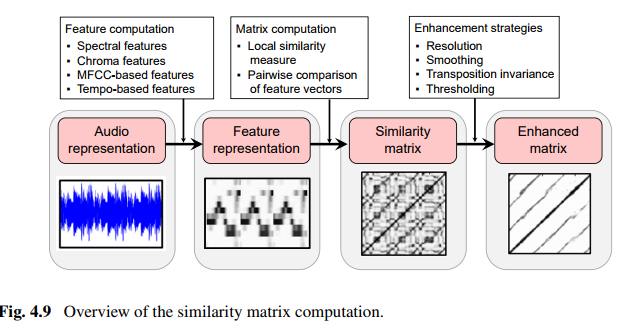

In [14]:
ipd.Image("../img/5.music_structure_analysis/f.4.9.PNG")

# SSM: 합성(synthetic) 생성

- 주어진 이산 시간 주석(annotation)에서 SSM을 생성하는 함수를 소개한다. 각 레이블에 대해 해당 섹션이 경로 관계, 블록 관계 또는 둘 다 공유하는지 여부를 지정할 수 있다. 또한 가우시안 스무딩 커널(Gaussian smoothing kernel)을 적용하여 구조적 요소를 평활화 할 수 있다. 마지막으로 가우시안 노이즈와의 중첩을 포함하여 SSM을 왜곡(distort)하는 다양한 설정이 있다. 매개변수 설정이 다른 SSM을 생성하는 Brahms 예를 보자.

In [15]:
def generate_ssm_from_annotation(ann, label_ann=None, score_path=1.0, score_block=0.5, main_diagonal=True,
                                 smooth_sigma=0.0, noise_power=0.0):
    """Generation of a SSM

    Args:
        ann (list): Description of sections (see explanation above)
        label_ann (dict): Specification of property (path, block relation) (Default value = None)
        score_path (float): SSM values for occurring paths (Default value = 1.0)
        score_block (float): SSM values of blocks covering the same labels (Default value = 0.5)
        main_diagonal (bool): True if a filled main diagonal should be enforced (Default value = True)
        smooth_sigma (float): Standard deviation of a Gaussian smoothing filter.
            filter length is 4*smooth_sigma (Default value = 0.0)
        noise_power (float): Variance of additive white Gaussian noise (Default value = 0.0)

    Returns:
        S (np.ndarray): Generated SSM
    """
    N = int(ann[-1][1] + 1)
    S = np.zeros((N, N))

    if label_ann is None:
        all_labels = [s[2] for s in ann]
        labels = list(set(all_labels))
        label_ann = {l: [True, True] for l in labels}

    for s in ann:
        for s2 in ann:
            if s[2] == s2[2]:
                if (label_ann[s[2]])[1]:
                    S[s[0]:s[1]+1, s2[0]:s2[1]+1] = score_block

                if (label_ann[s[2]])[0]:
                    length_1 = s[1] - s[0] + 1
                    length_2 = s2[1] - s2[0] + 1

                    if length_1 >= length_2:
                        scale_fac = length_2 / length_1
                        for i in range(s[1] - s[0] + 1):
                            S[s[0]+i, s2[0]+int(i*scale_fac)] = score_path
                    else:
                        scale_fac = length_1 / length_2
                        for i in range(s2[1] - s2[0] + 1):
                            S[s[0]+int(i*scale_fac), s2[0]+i] = score_path
    if main_diagonal:
        for i in range(N):
            S[i, i] = score_path
    if smooth_sigma > 0:
        S = scipy.ndimage.gaussian_filter(S, smooth_sigma)
    if noise_power > 0:
        S = S + np.sqrt(noise_power) * np.random.randn(S.shape[0], S.shape[1])
    return S

In [16]:
ann_frames2, color_ann2 = read_structure_annotation(fn_ann, Fs=0.5, remove_digits=True, index=True)

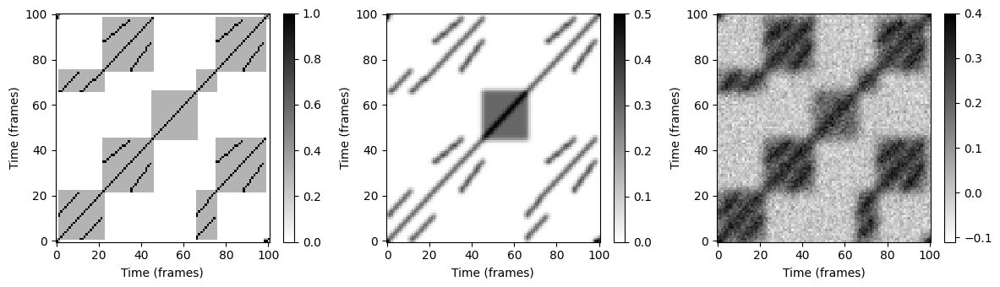

In [17]:
figsize = (12,3.5)
fig, ax = plt.subplots(1, 3, figsize=figsize)

S = generate_ssm_from_annotation(ann_frames2, score_path=1, score_block=0.3)
plot_matrix(S, ax=[ax[0]], xlabel='Time (frames)', ylabel='Time (frames)');

label_ann = {'A':[True, False], 'B':[True, False], 'C':[False, True], '' : [True, False]}
S = generate_ssm_from_annotation(ann_frames2, label_ann, score_path=1, score_block=0.3, smooth_sigma=1)
plot_matrix(S, ax=[ax[1]], xlabel='Time (frames)', ylabel='Time (frames)');

S = generate_ssm_from_annotation(ann_frames2, score_path=1, score_block=0.2, smooth_sigma=2, noise_power=0.001)
plot_matrix(S, ax=[ax[2]], xlabel='Time (frames)', ylabel='Time (frames)');
plt.tight_layout()
plt.show() 

# SSM: 피쳐 스무딩 (feature smoothing)

**Moderate Smoothing**

- 다음 예에서 피쳐 레이트(feature rate)가 10Hz인 정규화된 크로마 특징부터 보자. SSM 결과는 반복 구조에 대해 매우 상세히 설명해준다. 
    - 하지만 반복되는 $A$ 부분 및 $B$ 부분 세그먼트에 해당하는 경로 구조가 표시되더라도 SSM은 상당히 노이지(noisy)해 보이고, 전체 음악 구조에만 관심이 있는 경우, 표시된 세부 정보 중 많은 부분이 관련이 없다.
    
- $L=41$(오디오의 약 4초에 해당)의 스무딩 길이와 $H=10$(feature rate $1$Hz)의 다운샘플링(downsamping)을 사용하여 많은 세부 정보가 smoothed out된 SSM을 보자. 구조적으로 관련된 일부 경로 및 블록 구조가 더욱 두드러진다.

In [18]:
# Chroma Feature Sequence and SSM (10 Hz)
C = librosa.feature.chroma_stft(y=x, sr=Fs, tuning=0, norm=2, hop_length=2205, n_fft=4410)
Fs_C = Fs/2205

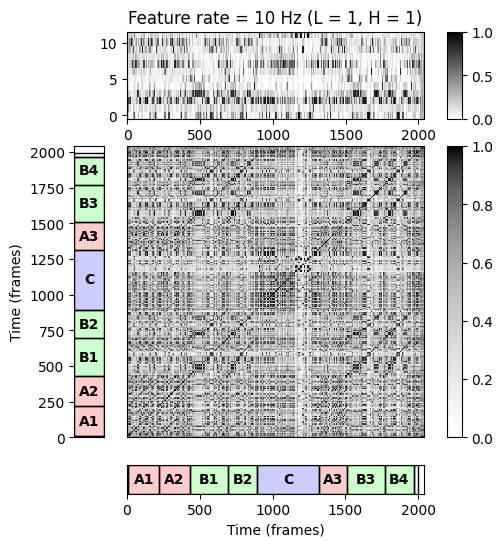

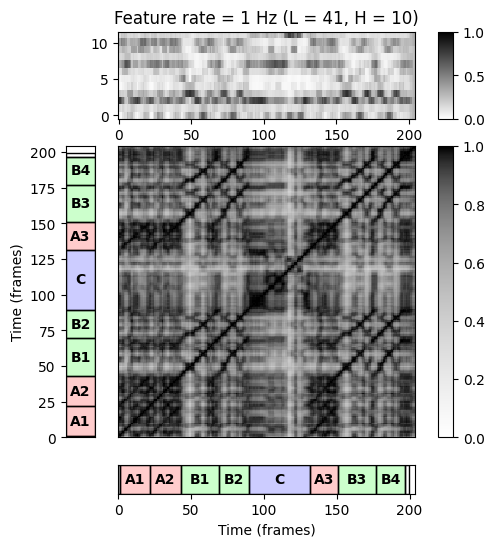

In [19]:
# Chroma Feature Sequence and SSM (10 Hz)
L, H = 1, 1
X, Fs_feature = smooth_downsample_feature_sequence(C, Fs_C, 
                        filt_len=L, down_sampling=H)
X = normalize_feature_sequence(X, norm='2', threshold=0.001)
S = compute_sm_dot(X,X)

ann_frames = convert_structure_annotation(ann, Fs=Fs_feature)
fig, ax = plot_feature_ssm(X, 1, S, 1, ann_frames, x_duration*Fs_feature,
            label='Time (frames)', color_ann=color_ann, clim=[0,1], clim_X=[0,1],
            title='Feature rate = %0.0f Hz (L = %d, H = %d)'%(Fs_feature,L,H))


# Chroma Feature Sequence and SSM (10 Hz)
L, H = 41, 10
X, Fs_feature = smooth_downsample_feature_sequence(C, Fs_C, 
                        filt_len=L, down_sampling=H)
X = normalize_feature_sequence(X, norm='2', threshold=0.001)
S = compute_sm_dot(X,X)

ann_frames = convert_structure_annotation(ann, Fs=Fs_feature)
fig, ax = plot_feature_ssm(X, 1, S, 1, ann_frames, x_duration*Fs_feature, 
            label='Time (frames)', color_ann=color_ann, clim=[0,1], clim_X=[0,1],
            title='Feature rate = %0.0f Hz (L = %d, H = %d)'%(Fs_feature,L,H))

**Strong Smoothing**

- 스무딩 길이를 더 늘리고 특징 비율(feature rate)을 줄이면 거친(rough) 고조파가 강조된다. 
- 큰 스무딩 윈도우를 사용하면 관련 경로 구조가 번져서 다음 단계에서 손실될 수 있다. 그러나 동질성 기반 구조 분석과 같은 다른 응용의 경우 큰 윈도우에 대한 평균을 구하는 것이 도움이 될 수 있다.

- $L=161$($16$초) 및 $H=20$($0.5$Hz의 피쳐 레이트)를 사용할 때와 $L=321$($32$초) 및 $H=40$($0.25$ Hz의 피쳐 레이트)

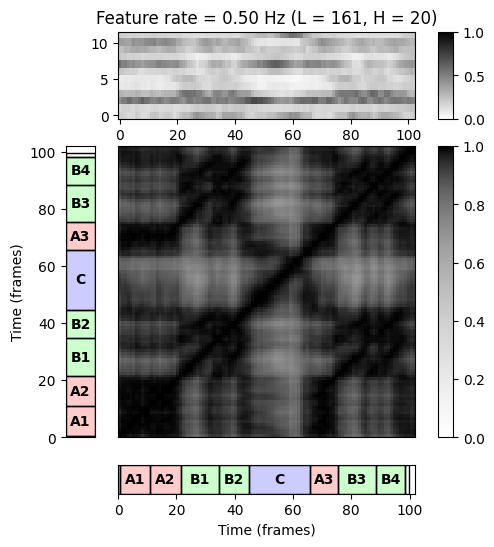

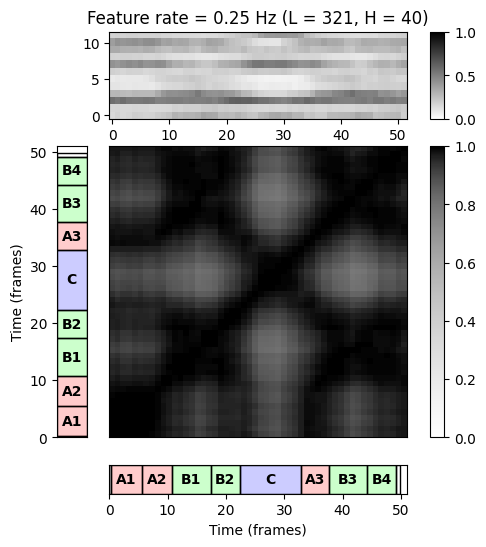

In [20]:
# Chroma Feature Sequence and SSM (0.5 Hz)
L, H = 161, 20
X, Fs_feature = smooth_downsample_feature_sequence(C, Fs_C, 
                        filt_len=L, down_sampling=H)
X = normalize_feature_sequence(X, norm='2', threshold=0.001)
S = compute_sm_dot(X,X)

ann_frames = convert_structure_annotation(ann, Fs=Fs_feature)
fig, ax = plot_feature_ssm(X, 1, S, 1, ann_frames, x_duration*Fs_feature, 
            label='Time (frames)', color_ann=color_ann, clim=[0,1], clim_X=[0,1],
            title='Feature rate = %0.2f Hz (L = %d, H = %d)'%(Fs_feature,L,H))


# Chroma Feature Sequence and SSM (0.25 Hz)
L, H = 321, 40
X, Fs_feature = smooth_downsample_feature_sequence(C, Fs_C, 
                        filt_len=L, down_sampling=H)
X = normalize_feature_sequence(X, norm='2', threshold=0.001)
S = compute_sm_dot(X,X)

ann_frames = convert_structure_annotation(ann, Fs=Fs_feature)
fig, ax = plot_feature_ssm(X, 1, S, 1, ann_frames, x_duration*Fs_feature, 
            label='Time (frames)', color_ann=color_ann, clim=[0,1], clim_X=[0,1],
            title='Feature rate = %0.2f Hz (L = %d, H = %d)'%(Fs_feature,L,H))

**Median Filtering**

- 평균 필터링의 대안으로 **중앙값(median) 필터링**에 대해서도 논의한 바 있다. 중앙값 필터링은 동질의(homogeneous) 영역 사이의 가장자리 또는 날카로운 과도(sharp transient) 현상을 더 잘 보존하는 경향이 있다. 
- 다음 그림에서 평균 및 중앙값 필터링으로 얻은 SSM을 비교해보자.

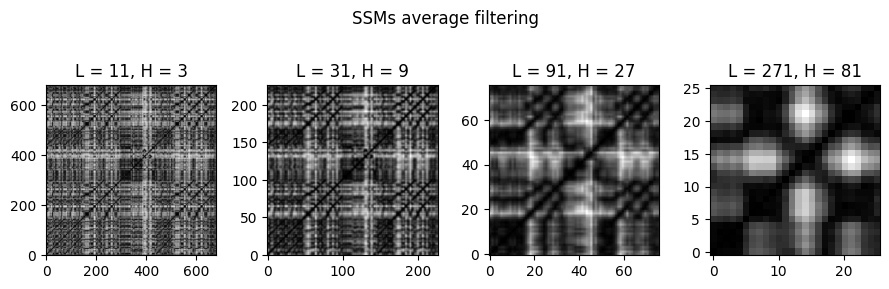

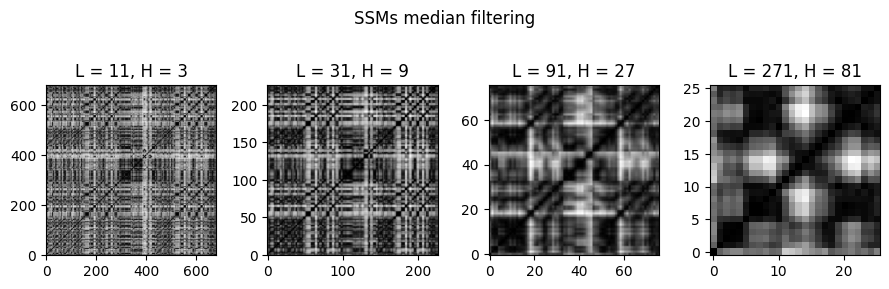

In [21]:
# Chroma Feature Sequence and SSM (0.5 Hz)
L_iter = [11, 31, 91, 271] 
H_iter = [ 3, 9, 27, 81]
num_iter = len(L_iter)

fig = plt.figure(figsize=(9,3))
plt.suptitle('SSMs average filtering')
for i in range(num_iter):
    L = L_iter[i]
    H = H_iter[i]
    X, Fs_feature = smooth_downsample_feature_sequence(C, Fs_C, 
                        filt_len=L, down_sampling=H)
    X = normalize_feature_sequence(X, norm='2', threshold=0.001)
    S = compute_sm_dot(X,X)
    ax = fig.add_subplot(1, num_iter, i+1)
    #ax = plt.subplot(1, num_iter, i+1)
    im = plt.imshow(S, cmap='gray_r', aspect='equal', origin='lower')
    ax.title.set_text('L = %d, H = %d'%(L,H))
plt.tight_layout() 
plt.show()

fig = plt.figure(figsize=(9,3))
plt.suptitle('SSMs median filtering')
for i in range(num_iter):
    L = L_iter[i]
    H = H_iter[i]
    X, Fs_feature = median_downsample_feature_sequence(C, Fs_C, 
                        filt_len=L, down_sampling=H)
    X = normalize_feature_sequence(X, norm='2', threshold=0.001)
    S = compute_sm_dot(X,X)
    ax = fig.add_subplot(1, num_iter, i+1)
    im = plt.imshow(S, cmap='gray_r', aspect='equal', origin='lower')
    ax.title.set_text('L = %d, H = %d'%(L,H))
plt.tight_layout() 
plt.show()

# SSM: 경로 향상 (path enhancement)

## 대각 스무딩 (Diagonal Smoothing)

- 유사성 행렬의 중요한 속성 중 하나는 주 대각선과 평행한 높은 유사성의 경로 모양이다.
- 이러한 각 경로는 각각 가로 및 세로 축에 경로를 투영하여 얻은 두 세그먼트의 유사성을 인코딩한다. 이러한 경로의 식별과 추출은 많은 음악 분석의 응용 단계이다. 그러나 음악적 및 음향적 변화로 인해 경로 구조는 종종 매우 노이지하며 추출하기 어려워 진다.
- 이러한 노이즈는 피쳐 계산 단계에서 더 긴 분석 윈도우를 사용하고 피쳐 레이트를 조정함으로써 어느 정도 줄일 수 있다.
- 경로 구조를 더욱 향상시키기 위한 일반적인 전략 중 하나는 주 대각선 방향을 따라 일종의 스무딩 필터를 적용하여 $\mathbf{S}$의 대각선 정보를 강조하고 다른 구조의 노이즈를 제거하는 것이다.
- **대각 스무딩**(**diagonal smoothing**)이라고도 하는 이러한 필터링 과정은 동적 시스템(dynamical system) 분석에 널리 사용되는 **시간 지연 임베딩**(**time-delay embedding**) 개념과 밀접한 관련이 있다.

- $\mathbf{S}$를 $N\times N$ 크기의 SSM이라고 하고 $L\in\mathbb{N}$를 스무딩 필터의 길이(length)라고 하자. 평활화된 SSM $\mathbf{S}_L$을 다음과 같이 정의한다.
$$\mathbf{S}_L(n,m) := \frac{1}{L} \sum_{\ell=0}^{L-1} \mathbf{S}(n+\ell,m+\ell)$$
for $n,m\in[1:N-L+1]$

- $\mathbf{S}$를 적절하게 확장함으로써(예: **제로 패딩**으로 0열과 행이 추가됨) $n,m\in[1:N]$에 대해 $\mathbf{S}_L(n,m)$이 정의된다.

- **효율성 문제**를 생각했을 때, 행렬 기반 작업을 사용하여 스무딩 절차를 구현한다. 구현의 주요 아이디어는 다음과 같다.
    * $\ell\in[0:L-1]$에 대해 $\mathbf{S}$의 $\ell$-shifted 버전을 생성한다. 이를 위해 주 대각선을 따라 $\ell$ 위치만큼 $\mathbf{S}$를 이동시킨다.
    * 그런 다음 $\ell\in[0:L-1]$에서 $\ell$-이동된 버전을 합산한다. 결과 행렬을 $L$로 나누면 $\mathbf{S}_L$ 행렬이 된다.
    * 경계 효과를 처리하기 위해 $(N+L)$ 사각 행렬(all zero)로 시작하는 제로 패딩을 사용한다.

In [22]:
def filter_diag_sm(S, L):
    """Path smoothing of similarity matrix by forward filtering along main diagonal

    Args:
        S (np.ndarray): Similarity matrix (SM)
        L (int): Length of filter

    Returns:
        S_L (np.ndarray): Smoothed SM
    """
    N = S.shape[0]
    M = S.shape[1]
    S_L = np.zeros((N, M))
    S_extend_L = np.zeros((N + L, M + L))
    S_extend_L[0:N, 0:M] = S
    for pos in range(0, L):
        S_L = S_L + S_extend_L[pos:(N + pos), pos:(M + pos)]
    S_L = S_L / L
    return S_L


def subplot_matrix_colorbar(S, fig, ax, title='', Fs=1,
                            xlabel='Time (seconds)', ylabel='Time (seconds)',
                            clim=None, xlim=None, ylim=None, cmap=None, interpolation='nearest'):
    """Visualization function for showing zoomed sections of matrices

    Args:
        S: Similarity matrix (SM)
        fig: Figure handle
        ax: Axes handle
        title: Title for figure (Default value = '')
        Fs: Feature rate (Default value = 1)
        xlabel: Label for x-axis (Default value = 'Time (seconds)')
        ylabel: Label for y-axis (Default value = 'Time (seconds)')
        clim: Color limits (Default value = None)
        xlim: Limits for x-axis (Default value = None)
        ylim: Limits for x-axis (Default value = None)
        cmap: Colormap for imshow (Default value = None)
        interpolation: Interpolation value for imshow (Default value = 'nearest')

    Returns:
        im: Imshow handle
    """
    if cmap is None:
        cmap = compressed_gray_cmap(alpha=-100)
    len_sec = S.shape[0] / Fs
    extent = [0, len_sec, 0, len_sec]
    im = ax.imshow(S, aspect='auto', extent=extent, cmap=cmap,  origin='lower', interpolation=interpolation)
    fig.sca(ax)
    fig.colorbar(im)
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    if xlim is not None:
        ax.set_xlim(xlim)
    if ylim is not None:
        ax.set_ylim(ylim)
    if clim is not None:
        im.set_clim(clim)
    return im

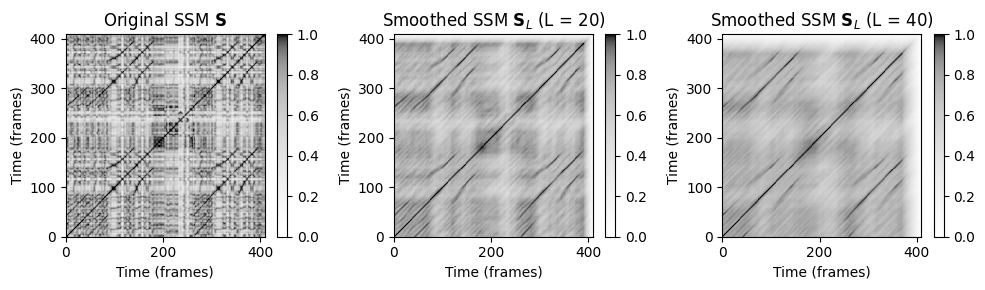

In [23]:
L, H = 21, 5
X, Fs_X = smooth_downsample_feature_sequence(C, Fs_C, 
                        filt_len=L, down_sampling=H)

X = normalize_feature_sequence(X, norm='2', threshold=0.001)
S = compute_sm_dot(X,X)


fig, ax = plt.subplots(1, 3, figsize=(10, 3))
subplot_matrix_colorbar(S, fig, ax[0], clim=[0,1], ylabel='Time (frames)', xlabel='Time (frames)',
                     title=r'Original SSM $\mathbf{S}$')
L = 20
S_L = filter_diag_sm(S, L)
subplot_matrix_colorbar(S_L, fig, ax[1], clim=[0,1], ylabel='Time (frames)', xlabel='Time (frames)',
                     title=r'Smoothed SSM $\mathbf{S}_{L}$ (L = %d)'%L)
L_long = 40
S_L_long = filter_diag_sm(S, L_long)
subplot_matrix_colorbar(S_L_long, fig, ax[2], clim=[0,1], ylabel='Time (frames)', xlabel='Time (frames)',
                     title=r'Smoothed SSM $\mathbf{S}_{L}$ (L = %d)'%L_long)

plt.tight_layout()
plt.show()

- 비교할 세그먼트 간에 상대적인 템포 차이가 없는 경우 주 대각선을 따라 간단한 필터링이 잘 작동한다. 그러나 이 가정은 파트가 더 빠르거나 더 느린 템포로 반복될 때는 위반된다. 
- Brahms 예의 B 섹션에서 짧은 B2 섹션은 B1 섹션보다 훨씬 빠르게 재생된다. B2 섹션의 시작 부분만 B1 섹션의 시작 부분보다 훨씬 빠르게 재생되는 반면, 두 섹션은 파트의 끝 부분에서 거의 동일한 템포를 가진다. 
- 이로 인해 경로가 주 대각선(특히 시작 부분)과 정확히 평행하지 않으므로 주 대각선 방향으로 평균화 필터를 적용하면 일부 경로 구조가 파괴된다. 이것은 필터 길이 L이 큰 경우에 발생한다.

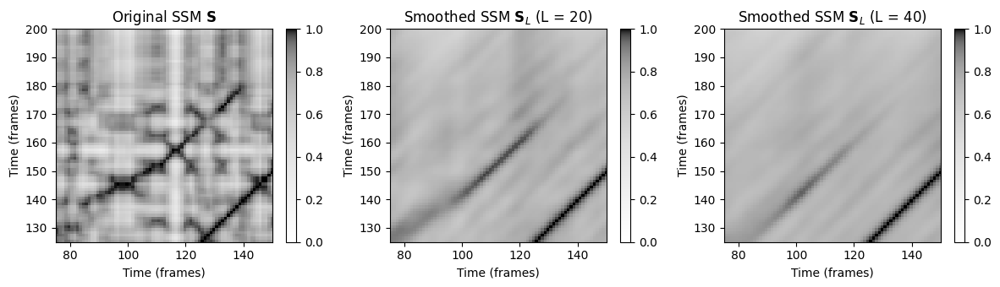

In [24]:
xlim = [75, 150]
ylim = [125, 200]

fig, ax = plt.subplots(1, 3, figsize=(12, 3.5))
subplot_matrix_colorbar(S, fig, ax[0], clim=[0,1], xlim=xlim, ylim=ylim,
                        title=r'Original SSM $\mathbf{S}$', 
                        xlabel='Time (frames)', ylabel='Time (frames)')
subplot_matrix_colorbar(S_L, fig, ax[1], clim=[0,1], xlim=xlim, ylim=ylim,
                        title=r'Smoothed SSM $\mathbf{S}_{L}$ (L = %d)'%L, 
                        xlabel='Time (frames)', ylabel='Time (frames)')
subplot_matrix_colorbar(S_L_long, fig, ax[2], clim=[0,1], xlim=xlim, ylim=ylim,
                        title=r'Smoothed SSM $\mathbf{S}_{L}$ (L = %d)'%L_long, 
                        xlabel='Time (frames)', ylabel='Time (frames)')

plt.tight_layout()
plt.show()

## 다중 필터링 (Multiple Filtering)

- 상대적인 템포 차이로 인한 비대각선 경로 구조를 처리하기 위해, 특정 가정 하에 이러한 구조를 보존하는 **다중 필터링** 접근 방식을 도입한다. 
- 이 접근법의 주요 아이디어는 주 대각선으로 정의된 방향의 이웃에 있는 다양한 방향을 따라 유사성 행렬을 필터링하는 것이다. 이러한 각 방향은 템포 차이에 해당하며, 별도로 필터링된 유사성 매트릭스가 생성된다. 최종 유사성 행렬은 이러한 모든 행렬에 대해 셀별 최대값을 취하여 얻는다. 
- 이러한 방식으로 경로 구조는 로컬 템포 변형이 있는 경우에도 향상된다.

- 템포 차이가 실수 $\theta>0$로 주어진다고 가정하자. $(1,\theta)$ 방향으로 평활화된 자기 유사성 행렬을 다음과 같이 정의한다.
$$\mathbf{S}_{L,\theta}(n,m) := \frac{1}{L} \sum_{\ell=0}^{L-1} \mathbf{S}(n+\ell,m+[\ell\cdot\theta])$$
    - $[\ell\cdot\theta]$는 실수 $\ell\cdot\theta$에 가장 가까운 정수
    
- 다시, 행렬 $\mathbf{S}$를 적절히 제로-패딩함으로써 $\mathbf{S}_{L,\theta}$가 $n,m\in[1:N]$에 대해 정의되었다고 가정할 수 있다.

- 실제로는 주어진 음악 녹음에서 발생할 수 있는 로컬 템포 차이를 알 수 없다. 또한 두 반복 섹션 간의 상대적인 템포 차이는 시간이 지남에 따라 변경될 수 있다. 따라서 다른 상대적 템포 차이에 대한 템포 매개변수 $\theta\in\Theta$로 구성된 (유한) 집합 $\Theta$를 고려한다. 그런 다음 각 $\theta$에 대해 행렬 $\mathbf{S}_{L,\theta}$를 계산하고 모든 $\theta\in\Theta$에 대한 셀별 최대화로 최종 행렬 $\mathbf{S}_{L,\Theta}$를 얻는다.
$$\mathbf{S}_{L,\Theta}(n,m) := \max_{\theta\in\Theta} \mathbf{S}_{L,\theta}(n,m)$$

- $\Theta=\{1\}$를 선택하면 $\mathbf{S}_{L,\Theta}=\mathbf{S}_{L}$의 경우로 축소된다. 
- 실제로는 $\Theta$ 집합을 결정하기 위해 예상되는 상대 템포 차이에 대한 사전 정보를 사용할 수 있다. 
    - 예를 들어, 반복되는 세그먼트 간의 상대적 템포 차이가 $50$퍼센트보다 큰 경우는 거의 발생하지 않으므로, $\Theta$를 대략 $-50$에서 $+50$퍼센트까지의 템포 변화를 처리할 수 있도록 선택할 수 있다. 
- 또한 실제로는 상대적으로 적은 수의 템포 매개변수만 고려하면 템포 범위를 잘 커버할 수 있다. 
    - 예를 들어, 집합 $\Theta=\{0.66,0.81,1.00,1.22,1.50\}$ (로그 간격의 템포 매개변수 포함)은 대략 $-50$에서 $+50$ 퍼센트의 템포 변화를 다룬다.

In [25]:
def compute_tempo_rel_set(tempo_rel_min, tempo_rel_max, num):
    """Compute logarithmically spaced relative tempo values

    Args:
        tempo_rel_min (float): Minimum relative tempo
        tempo_rel_max (float): Maximum relative tempo
        num (int): Number of relative tempo values (inlcuding the min and max)

    Returns:
        tempo_rel_set (np.ndarray): Set of relative tempo values
    """
    tempo_rel_set = np.exp(np.linspace(np.log(tempo_rel_min), np.log(tempo_rel_max), num))
    return tempo_rel_set

In [26]:
tempo_rel_min = 0.66
tempo_rel_max = 1.5
num = 5
tempo_rel_set = compute_tempo_rel_set(tempo_rel_min=tempo_rel_min, tempo_rel_max=tempo_rel_max, num=num) 
print(tempo_rel_set)

[0.66       0.81036517 0.99498744 1.22167146 1.5       ]


- 스무딩 길이 매개변수 $L\in\mathbb{N}$ 및 상대적 템포 차이의 이산 집합 $\Theta$는 스무딩 품질을 제어하기 위한 두 가지 주요 매개변수이다. 
- 대각선 스무딩과 마찬가지로 다중 필터링 접근 방식의 **구현**은 효율적으로 계산할 수 있는 전체 행렬 연산으로 표현된다. 구현의 주요 아이디어는 다음과 같다.
    * 각 템포 매개변수 $\theta\in\Theta$에 대해 $\theta$에 의해 결정된 계수로 한 축을 따라 SSM을 리샘플링한다. 리샘플링은 $\theta$로 지정된 상대 템포 차이를 시뮬레이션한다.
    * 리샘플링된 각 행렬에 대해 길이 $L$의 대각선 필터링을 적용한다.
    * 필터링된 각 행렬은 (역)리샘플링을 적용하여 원래 형식으로 다시 변환된다.
    * $\theta\in\Theta$에 대한 결과 행렬의 셀별 최대값을 취하면 행렬 $\mathbf{S}_{L,\Theta}$를 얻을 수 있다.

In [27]:
def filter_diag_mult_sm(S, L=1, tempo_rel_set=np.asarray([1]), direction=0):
    """Path smoothing of similarity matrix by filtering in forward or backward direction
    along various directions around main diagonal.
    Note: Directions are simulated by resampling one axis using relative tempo values

    Args:
        S (np.ndarray): Self-similarity matrix (SSM)
        L (int): Length of filter (Default value = 1)
        tempo_rel_set (np.ndarray): Set of relative tempo values (Default value = np.asarray([1]))
        direction (int): Direction of smoothing (0: forward; 1: backward) (Default value = 0)

    Returns:
        S_L_final (np.ndarray): Smoothed SM
    """
    N = S.shape[0]
    M = S.shape[1]
    num = len(tempo_rel_set)
    S_L_final = np.zeros((N, M))

    for s in range(0, num):
        M_ceil = int(np.ceil(M / tempo_rel_set[s]))
        resample = np.multiply(np.divide(np.arange(1, M_ceil+1), M_ceil), M)
        np.around(resample, 0, resample)
        resample = resample - 1
        index_resample = np.maximum(resample, np.zeros(len(resample))).astype(np.int64)
        S_resample = S[:, index_resample]

        S_L = np.zeros((N, M_ceil))
        S_extend_L = np.zeros((N + L, M_ceil + L))

        # Forward direction
        if direction == 0:
            S_extend_L[0:N, 0:M_ceil] = S_resample
            for pos in range(0, L):
                S_L = S_L + S_extend_L[pos:(N + pos), pos:(M_ceil + pos)]

        # Backward direction
        if direction == 1:
            S_extend_L[L:(N+L), L:(M_ceil+L)] = S_resample
            for pos in range(0, L):
                S_L = S_L + S_extend_L[(L-pos):(N + L - pos), (L-pos):(M_ceil + L - pos)]

        S_L = S_L / L
        resample = np.multiply(np.divide(np.arange(1, M+1), M), M_ceil)
        np.around(resample, 0, resample)
        resample = resample - 1
        index_resample = np.maximum(resample, np.zeros(len(resample))).astype(np.int64)

        S_resample_inv = S_L[:, index_resample]
        S_L_final = np.maximum(S_L_final, S_resample_inv)

    return S_L_final

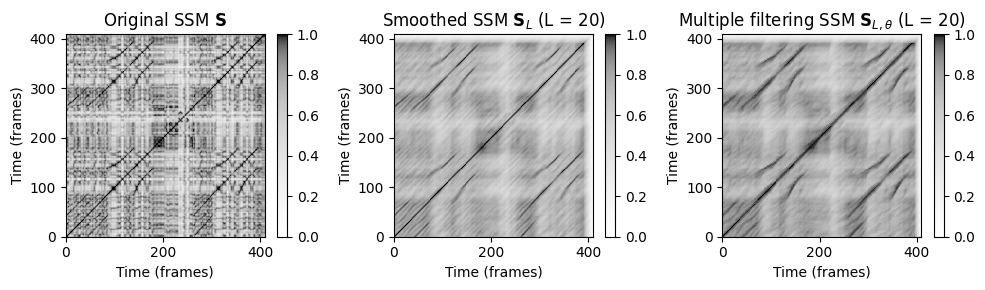

In [28]:
tempo_rel_min = 0.66
tempo_rel_max = 1.5
num = 5
tempo_rel_set = compute_tempo_rel_set(tempo_rel_min=tempo_rel_min, tempo_rel_max=tempo_rel_max, num=num) 
L = 20
S_L = filter_diag_sm(S, L)
S_L_mult = filter_diag_mult_sm(S, L, tempo_rel_set)

fig, ax = plt.subplots(1, 3, figsize=(10, 3))
subplot_matrix_colorbar(S, fig, ax[0], clim=[0,1], xlabel='Time (frames)', ylabel='Time (frames)',
                        title=r'Original SSM $\mathbf{S}$')
subplot_matrix_colorbar(S_L, fig, ax[1], clim=[0,1], xlabel='Time (frames)', ylabel='Time (frames)',
                        title=r'Smoothed SSM $\mathbf{S}_{L}$ (L = %d)'%L)
subplot_matrix_colorbar(S_L_mult, fig, ax[2], clim=[0,1], xlabel='Time (frames)', ylabel='Time (frames)',
                        title=r'Multiple filtering SSM $\mathbf{S}_{L,\theta}$ (L = %d)'%L)

plt.tight_layout()
plt.show()

## Forward-Backward 스무딩

- 이전 그림은 특히 경로 구조의 끝에 페이딩 아티팩트(fading artifact)가 있음을 보여준다. 이 아티팩트의 이유는 지금까지 설명한 스무딩 절차가 순방향으로 작동하기 때문이다. 페이딩 아티팩트를 방지하기 위한 방법으로 역방향으로 평균화 필터를 추가로 적용할 수 있다. 최종 자기 유사성 행렬은 **forward-smoothed** 및 **backward-smoothed** 행렬에 대해 셀별 최대값을 취하여 얻는다.

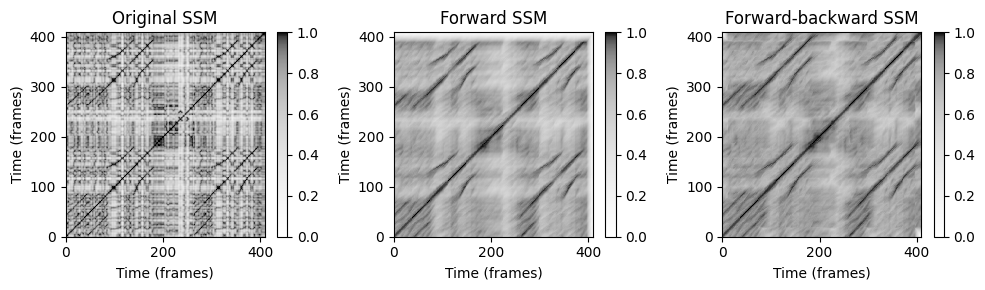

In [29]:
tempo_rel_min = 0.66
tempo_rel_max = 1.5
num = 5
tempo_rel_set = compute_tempo_rel_set(tempo_rel_min=tempo_rel_min, tempo_rel_max=tempo_rel_max, num=num) 
L = 20
S_forward = filter_diag_mult_sm(S, L, tempo_rel_set, direction=0)
S_backward = filter_diag_mult_sm(S, L, tempo_rel_set, direction=1)
S_final = np.maximum(S_forward, S_backward)

fig, ax = plt.subplots(1, 3, figsize=(10, 3))
subplot_matrix_colorbar(S, fig, ax[0], clim=[0,1], 
                        title=r'Original SSM', xlabel='Time (frames)', ylabel='Time (frames)')
subplot_matrix_colorbar(S_forward, fig, ax[1], clim=[0,1],
                        title=r'Forward SSM', xlabel='Time (frames)', ylabel='Time (frames)')
subplot_matrix_colorbar(S_final, fig, ax[2], clim=[0,1], 
                        title=r'Forward-backward SSM', xlabel='Time (frames)', ylabel='Time (frames)')

plt.tight_layout()
plt.show()

- 위의 리샘플 기반(resample-based) 접근법의 대안은 Librosa에서 구현된 것처럼 여러 2D 컨볼루션 커널(각 방향에 대해 하나의 커널)을 적용하는 것이다. 또 다른 수정 방법은 페이딩 부산물을 방지하기 위해 중앙값 필터링(평균 필터링 대신)을 사용하는 것이다.

# SSM: 조옮김 불변 (Transposition Invariance)

## 조옮김된(transposed) SSM

**순환 시프트 연산자 (Cyclic Shift Operator)**

- 이미 조옮김(transposition)이 크로마 특징을 주기적으로 이동하여 시뮬레이션할 수 있음을 확인한 바 있다(4.1. 오디오 동기화 피쳐). $[0:11]$ 집합으로 12개 크로마 값을 식별하면 순환 이동은 순환 이동 연산자 $\rho:\mathbb{R}^{12} \to \mathbb{R}^{12}$에 의해 모델링된다. 
$$\rho(x):=(x(11),x(0),x(1),\ldots,x(10))^\top$$
for $x=(x(0),x(1),\ldots,x(10),x(11))^\top\in\mathbb{R}^{12}$. 
    
- $i$의 반음 위 순환 이동을 정의하는 $\rho^i:=\rho\circ\rho^{i-1}$ for $i\in\mathbb{N}$ 를 얻기 위해 순환 이동 연산자가 연속적으로 적용될 수 있다. 

- $\rho^{12}(x) = x$는 크로마 벡터를 12반음(1옥타브) 위로 주기적으로 이동하여 원래 벡터를 복구한다. 크로마그램의 모든 프레임에 순환 이동 연산자를 동시에 적용하면 전체 크로마그램이 수직 방향으로 순환 이동하게 된다. 

- $X=(x_1,x_2,\ldots,x_N)$를 특징 시퀀스라고 하자. 그러면 **$i$-조옮김(-transposed) 특징 행렬** 은 다음과 같이 주어진다.
$$\rho^i(X)=(\rho^i(x_1),\rho^i(x_2),\ldots,\rho^i(x_N))$$

In [30]:
def shift_cyc_matrix(X, shift=0):
    """Cyclic shift of features matrix along first dimension

    Args:
        X (np.ndarray): Feature respresentation
        shift (int): Number of bins to be shifted (Default value = 0)

    Returns:
        X_cyc (np.ndarray): Cyclically shifted feature matrix
    """
    # Note: X_cyc = np.roll(X, shift=shift, axis=0) does to work for jit
    K, N = X.shape
    shift = np.mod(shift, K)
    X_cyc = np.zeros((K, N))
    X_cyc[shift:K, :] = X[0:K-shift, :]
    X_cyc[0:shift, :] = X[K-shift:K, :]
    return X_cyc

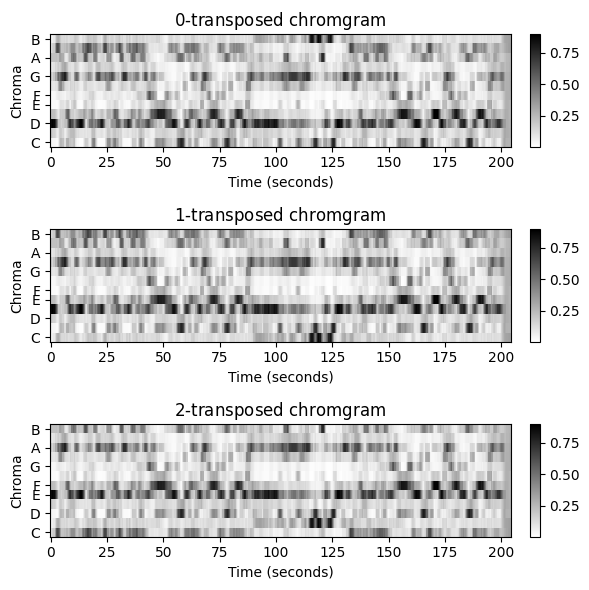

In [31]:
shift_set = [0,1,2]
shift_num = len(shift_set)

fig, ax = plt.subplots(shift_num, 2, gridspec_kw={'width_ratios': [1, 0.02]}, figsize=(6, 6))   
                                          
for m in range(shift_num):
    shift = shift_set[m]
    X_cyc = shift_cyc_matrix(X, shift)    
    plot_chromagram(X_cyc, Fs=Fs_X, ax=[ax[m,0], ax[m,1]], chroma_yticks=[0,2,4,5,7,9,11],
                     title=r'$%d$-transposed chromgram'%shift, ylabel='Chroma', colorbar=True);

plt.tight_layout()
plt.show() 

- 동일한 멜로디 또는 조화 진행을 공유하지만 하나 또는 여러 개의 반음이 조옮김된 유사한 세그먼트를 감지해보자. 

- 주어진 특징 시퀀스 $X=(x_1,x_2,\ldots,x_N)$에 대해, **$i$-조옮김(-transposed) 자기-유사성 행렬** $\rho^i(\mathrm{S})$를 다음과 같이 정의한다.
$$\rho^i(\mathrm{S})(n,m):=s(\rho^i(x_n),x_m)$$
    - for $n,m\in[1:N]$ and $i\in\mathbb{Z}$
    - $\rho^{12}(\mathrm{S})=\mathrm{S}$

- 직관적으로 $\rho^i(\mathrm{S})$는 원본 음악 녹음($X=(x_1,x_2,\ldots,x_N)$로 표현됨)과 $i$ 반음 위쪽($i$-transposed 특징 시퀀스로 표시됨)으로 조옮김된 음악 녹음 간의 유사성 관계를 설명한다.

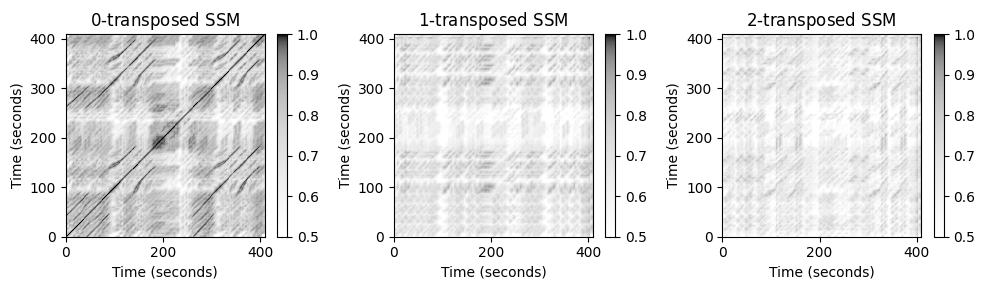

In [32]:
L = 8
tempo_rel_set = np.asarray([1])
shift_set = np.asarray([0,1,2])
shift_num = len(shift_set)

fig, ax = plt.subplots(1, shift_num, figsize=(10, 3))
for m in range(shift_num):
    shift = shift_set[m]
    X_cyc = shift_cyc_matrix(X, shift)    
    S = compute_sm_dot(X,X_cyc)
    S_forward = filter_diag_mult_sm(S, L, tempo_rel_set=tempo_rel_set, direction=0)
    S_backward = filter_diag_mult_sm(S, L, tempo_rel_set=tempo_rel_set, direction=1)
    S_final = np.maximum(S_forward, S_backward)
    subplot_matrix_colorbar(S_final, fig, ax[m], clim=[0.5,1], 
                        title=r'$%5d$-transposed SSM'%shift)

plt.tight_layout()
plt.show()   

## 조옮김-불변(Transposition-Invariant) SSM

- 일반적으로 음악 녹음에서 발생하는 조옮김의 종류를 모르기 때문에 상대적인 템포 편차(relative tempo deviations)를 처리할 때 이전과 유사한 전략을 적용한다. 12개의 서로 다른 순환 이동에 대해 셀별 최대값을 취하면 다음과 같이 정의된 단일 **조옮김-불변(transposition-invariant) 자기 유사성 행렬** $\mathrm{S}^\mathrm{TI}$를 얻는다.

$$\mathrm{S}^\mathrm{TI}(n,m):=\max_{i\in [0:11]} \,\rho^i(\mathrm{S})(n,m)$$

- 또한 추가 $N$-정사각 행렬 $\mathrm{I}$에 최대화 이동(shift) 지수를 저장하며 이를 **조옮김 인덱스 행렬**이라고 하고 다음과 같다.
$$\mathrm{I}(n,m):= \underset{i\in [0:11]}{\mathrm{argmax}} \,\,\, \rho^i(\mathrm{S})(n,m)$$

- 다음의 코드 셀에서는 조옮김-불변 SSM과 조옮김 인덱스 행렬을 계산하기 위한 구현을 제공한다. 
- 다음 사항에 유의해야 한다.
    * 이 함수는 `X`와 `Y` 두 가지 특징 시퀀스를 허용하여 보다 일반적이다. 'X = Y'의 경우는 이 노트북에서 고려된 SSM 케이스로 축소된다.
    * 조옮김된 각 SSM에 대해 평활화(정방향, 역방향, 조합) 및 정규화가 적용된다.
    * 마지막에 (조옮김된 12개의 모든 SSM에 대해)단일 최대화를 갖는 대신, 최대화는 이동 인덱스 루프(shift index loop) 내에서 업데이트된다. 동시에 두 개의 행렬만 저장하면 되므로 메모리 요구 사항이 줄어든다.

In [33]:
def compute_sm_ti(X, Y, L=1, tempo_rel_set=np.asarray([1]), shift_set=np.asarray([0]), direction=2):
    """Compute enhanced similaity matrix by applying path smoothing and transpositions

    Args:
        X (np.ndarray): First feature sequence
        Y (np.ndarray): Second feature sequence
        L (int): Length of filter (Default value = 1)
        tempo_rel_set (np.ndarray): Set of relative tempo values (Default value = np.asarray([1]))
        shift_set (np.ndarray): Set of shift indices (Default value = np.asarray([0]))
        direction (int): Direction of smoothing (0: forward; 1: backward; 2: both directions) (Default value = 2)

    Returns:
        S_TI (np.ndarray): Transposition-invariant SM
        I_TI (np.ndarray): Transposition index matrix
    """
    for shift in shift_set:
        Y_cyc = shift_cyc_matrix(Y, shift)
        S_cyc = compute_sm_dot(X, Y_cyc)

        if direction == 0:
            S_cyc = filter_diag_mult_sm(S_cyc, L, tempo_rel_set, direction=0)
        if direction == 1:
            S_cyc = filter_diag_mult_sm(S_cyc, L, tempo_rel_set, direction=1)
        if direction == 2:
            S_forward = filter_diag_mult_sm(S_cyc, L, tempo_rel_set=tempo_rel_set, direction=0)
            S_backward = filter_diag_mult_sm(S_cyc, L, tempo_rel_set=tempo_rel_set, direction=1)
            S_cyc = np.maximum(S_forward, S_backward)
        if shift == shift_set[0]:
            S_TI = S_cyc
            I_TI = np.ones((S_cyc.shape[0], S_cyc.shape[1])) * shift
        else:
            # jit does not like the following lines
            # I_greater = np.greater(S_cyc, S_TI)
            # I_greater = (S_cyc > S_TI)
            I_TI[S_cyc > S_TI] = shift
            S_TI = np.maximum(S_cyc, S_TI)

    return S_TI, I_TI


def subplot_matrix_ti_colorbar(S, fig, ax, title='', Fs=1, xlabel='Time (seconds)', ylabel='Time (seconds)',
                               clim=None, xlim=None, ylim=None, cmap=None, alpha=1, interpolation='nearest',
                               ind_zero=False):
    """Visualization function for showing transposition index matrix

    Args:
        S: Self-similarity matrix (SSM)
        fig: Figure handle
        ax: Axes handle
        title: Title for figure (Default value = '')
        Fs: Feature rate (Default value = 1)
        xlabel: Label for x-axis (Default value = 'Time (seconds)')
        ylabel: Label for y-axis (Default value = 'Time (seconds)')
        clim: Color limits (Default value = None)
        xlim: Limits for x-axis (Default value = None)
        ylim: Limits for y-axis (Default value = None)
        cmap: Color map (Default value = None)
        alpha: Alpha value for imshow (Default value = 1)
        interpolation: Interpolation value for imshow (Default value = 'nearest')
        ind_zero: Use white (True) or black (False) color for index zero (Default value = False)

    Returns:
        im: Imshow handle
    """
    if cmap is None:
        color_ind_zero = np.array([0, 0, 0, 1])
        if ind_zero == 0:
            color_ind_zero = np.array([0, 0, 0, 1])
        else:
            color_ind_zero = np.array([1, 1, 1, 1])
        colorList = np.array([color_ind_zero, [1, 1, 0, 1],  [0, 0.7, 0, 1],  [1, 0, 1, 1],  [0, 0, 1, 1],
                             [1, 0, 0, 1], [0, 0, 0, 0.5], [1, 0, 0, 0.3], [0, 0, 1, 0.3], [1, 0, 1, 0.3],
                             [0, 0.7, 0, 0.3], [1, 1, 0, 0.3]])
        cmap = ListedColormap(colorList)
    len_sec = S.shape[0] / Fs
    extent = [0, len_sec, 0, len_sec]
    im = ax.imshow(S, aspect='auto', extent=extent, cmap=cmap,  origin='lower', alpha=alpha,
                   interpolation=interpolation)
    if clim is None:
        im.set_clim(vmin=-0.5, vmax=11.5)
    fig.sca(ax)
    ax_cb = fig.colorbar(im)
    ax_cb.set_ticks(np.arange(0, 12, 1))
    ax_cb.set_ticklabels(np.arange(0, 12, 1))
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    if xlim is not None:
        ax.set_xlim(xlim)
    if ylim is not None:
        ax.set_ylim(ylim)
    return im

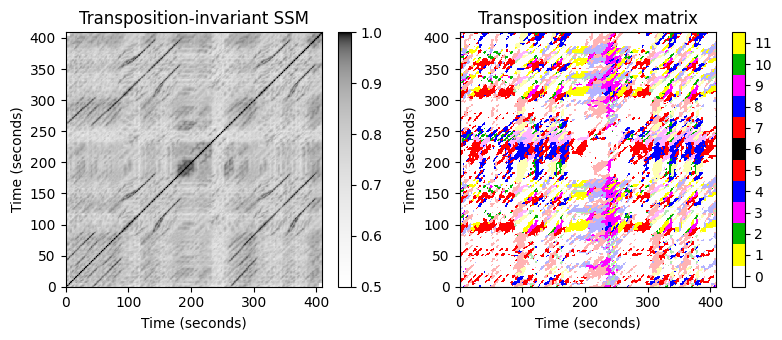

In [34]:
L = 8
tempo_rel_set = np.asarray([1])
shift_set = np.array(range(12))
S_TI, I_TI = compute_sm_ti(X, X, L=L, tempo_rel_set=tempo_rel_set, 
                           shift_set=shift_set, direction=2)

fig, ax = plt.subplots(1, 2, figsize=(8, 3.5))
subplot_matrix_colorbar(S_TI, fig, ax[0], clim=[0.5,1], 
                                  title='Transposition-invariant SSM')
subplot_matrix_ti_colorbar(I_TI, fig, ax[1], ind_zero=True,
                                  title='Transposition index matrix')
plt.tight_layout()
plt.show()

- 오른쪽의 조옮김 인덱스 행렬(transposition index matrix)을 자세히 살펴보자.
- 먼저 $\mathrm{I}$ 행렬이 $i=0$(흰색) 값을 가정하는 경우,
    - $(n,m)$ 셀의 $i=0$ 값은 $s(\rho^{i}(x_n),x_m)$가 $i=0$에 대해 최대값을 가정함을 나타낸다. 
    - 즉, 크로마 벡터 $x_m$은 $x_n$의 다른 이동된 버전보다 $x_n$에 더 가깝다.그러나 이것이 반드시 $x_m$이 절대적으로 $x_n$에 가깝다는 것을 의미하지는 않는다. 
    - 최대화 지수는 원래 SSM이 저비용 경로를 나타내는 모든 위치에서 $i=0$이다. 
- 다음으로 $\mathrm{I}$ 행렬이 $i=1$(노란색 ) 값을 가정하는 경우를 고려해보자. 
    - $(n,m)$ 셀의 $i=1$ 값은 반음 위로 이동했을 때 $x_n$이 $x_m$과 가장 비슷해짐을 나타낸다. 

## 매개변수에 따른 의존도

* 샘플링 속도(rate) $F_\mathrm{s}=22050~\mathrm{Hz}$의 오디오 신호로 시작하여 먼저 윈도우 및 홉 크기 매개변수가 필요한 STFT를 계산한다. 예를 들어 $N=4410$의 윈도우 크기와 $H=2050$의 홉 크기를 사용하면 특징 해상도가 $10~\mathrm{Hz}$가 된다.

* 둘째, 크로마그램을 도출하기 위해 스무딩 및 다운샘플링 전략을 적용한다. $41$ 특징(약 $4$초 커버)의 스무딩 윈도우와 $10$의 홉 크기를 사용하면 $1~\mathrm{Hz}$의 크로마 해상도가 생성된다.

* 셋째, SSM을 계산할 때 경로 향상(path enhancement)을 적용한다. 이것은 다시 길이 매개변수가 필요하다. 예를 들어 $20$ 길이를 사용하면 $20$초의 오디오에 해당한다. 순방향 및 역방향 스무딩을 적용하면 "번짐(smearing)"이 더욱 증가한다.

* 마지막으로, 다중 필터링을 적용하면 "번짐" 효과가 또 발생한다.

- 다음 그림은 이러한 매개변수의 선택이 최종 결과에 결정적인 영향을 미친다는 것을 보여준다. SSM 계산에서 경로 향상을 사용하지 않으면 노이즈가 많은 SSM이 발생하고 "scattered"된 조옮김 인덱스 분포가 발생한다. 경로 향상을 도입하면 구조적 속성이 향상되지만 과도한 평활화로 중요한 세부 사항의 손실이 발생할 수도 있다.

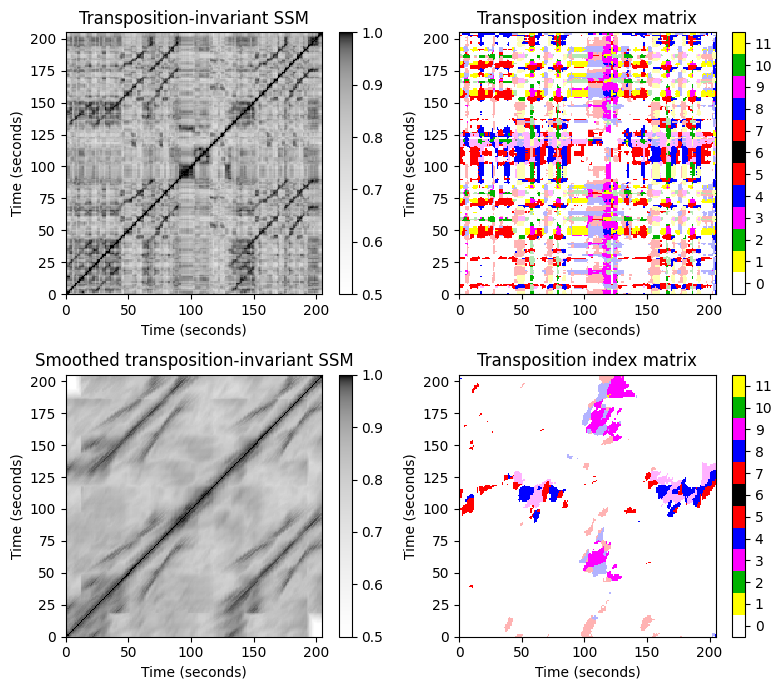

In [35]:
C = librosa.feature.chroma_stft(y=x, sr=Fs, tuning=0, norm=2, hop_length=2205, n_fft=4410)
Fs_C = Fs/2205

L_feature = 41
H_feature = 10
X, Fs_X = smooth_downsample_feature_sequence(C, Fs_C, 
                                    filt_len=L_feature, down_sampling=H_feature)
X = normalize_feature_sequence(X, norm='2', threshold=0.001)

tempo_rel_min = 0.66
tempo_rel_max = 1.5
num = 5
tempo_rel_set = compute_tempo_rel_set(tempo_rel_min=tempo_rel_min, tempo_rel_max=tempo_rel_max, num=num) 

shift_set = np.array(range(12))

L_set = [1, 20]
L_num = len(L_set)
title_set = ['Transposition-invariant SSM', 'Smoothed transposition-invariant SSM']

fig, ax = plt.subplots(L_num, 2, figsize=(8, 7))
for m in range(L_num):
    L = L_set[m]
    S_TI, I_TI = compute_sm_ti(X, X, L=L, tempo_rel_set=tempo_rel_set, shift_set=shift_set, direction=2)
    subplot_matrix_colorbar(S_TI, fig, ax[m,0], clim=[0.5,1], 
                                  title=title_set[m])
    subplot_matrix_ti_colorbar(I_TI, fig, ax[m,1], ind_zero=True,
                                  title='Transposition index matrix')
plt.tight_layout()
plt.show()

# SSM: 임계값 설정 (Thresholding)

- 많은 음악 분석 응용에서 자기 유사성 행렬(SSM)은 주어진 임계값(threshold) 아래로 떨어지는 모든 값을 억제하여 추가 처리된다. 

- 이러한 단계는 종종 가장 중요한 구조만 남기면서 원치 않는 노이즈 유사 구성요소를 상당히 감소시킨다. 반면에 약하지만 여전히 관련 있는 정보가 손실될 수 있다. 

- 사용된 임계값 전략은 최종 결과에 상당한 영향을 미칠 수 있으며 고려되는 응용의 맥락에서 신중하게 선택해야 한다. 

- 여기서는 **음이 아닌(nonnegative) 항목이 있는 모든 실수 값 행렬**에 적용할 수 있는 다양한 임계값 지정 기술을 소개한다.

- $\mathbf{S}\in\mathbb{R}_{\geq 0}^{N\times M}$가 차원이 $N,M \in\mathbb{N}$인 행렬이라고 가정하자

In [36]:
S = np.array([[8,7,6,5,4,3], [3,4,5,6,7,8], [2,3,4,5,6,7], [1,2,3,4,5,6]])
N, M = S.shape
print('Matrix S of dimension N=%d and M=%d:'%(N,M))
print(S)

Matrix S of dimension N=4 and M=6:
[[8 7 6 5 4 3]
 [3 4 5 6 7 8]
 [2 3 4 5 6 7]
 [1 2 3 4 5 6]]


## 전역 임계값 (Global Thresholding)

- 가장 간단한 방법은 **전역 임계값 global thresholding**을 적용하는 것이다. 여기서 주어진 임계값 매개변수 $\tau>0$ 보다 작은 행렬 $\mathbf{S}\in\mathbb{R}_{\geq 0}^{N\times M}$의 모든 값 $\mathbf{S}(n,m)$은 0으로 설정된다.

$$\mathbf{S}_\tau(n,m):=\left\{\begin{array}{ll}
    \mathbf{S}(n,m) &\quad \mbox{if $\mathbf{S}(n,m)\geq\tau$,}\\
    0,&\quad\mbox{otherwise.}
\end{array}\right.$$

- 또한 임계값 이상의 모든 값을 1로 설정하고 다른 모든 값을 0으로 설정하여 행렬의 **이진화**(binarization)를 적용할 수 있다.

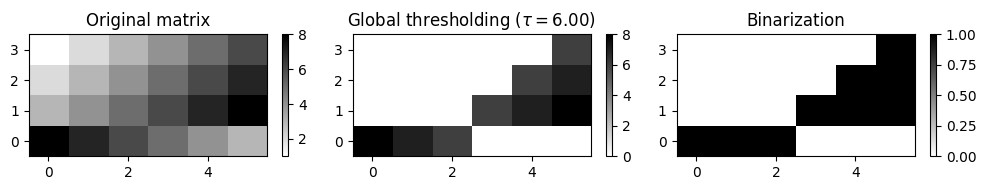

In [37]:
S_global = np.copy(S)

thresh = 6
S_global = np.copy(S)
S_global[S_global < thresh] = 0
S_binary = np.copy(S_global)
S_binary[S_global >= thresh] = 1


fig, ax = plt.subplots(1, 3, figsize=(10, 2))
plot_matrix(S, ax=[ax[0]], xlabel='', ylabel='',
                     title=r'Original matrix')
plot_matrix(S_global, ax=[ax[1]], xlabel='', ylabel='',
                     title=r'Global thresholding ($\tau = %0.2f$)'%thresh)
plot_matrix(S_binary, ax=[ax[2]], xlabel='', ylabel='', 
                     title=r'Binarization')
plt.tight_layout()
plt.show()

## 스케일링과 페널티 (Scaling and Penalty)

- 이진화 대신, 범위 $[\tau,\mu]$를 $[0,1]$로 선형 스케일링 할 수 있다.(단, $\mu:=\max_{n,m}\{\mathbf{S}(n,m)\}>\tau$의 경우, 그렇지 않으면 모든 항목 0으로 설정)
- 경우에 따라 추가 **페널티**(penalty) 매개변수 $\delta\leq 0$를 도입하여, 임계값 미만의 모든 원래 값을 $\delta$ 값으로 설정하는 것이 도움이 될 수도 있다. 

- 다음 그림은 스케일링 전과 후의 결과를 보여준다. 또한 페널티 매개변수 $\delta=-2$를 적용한다.

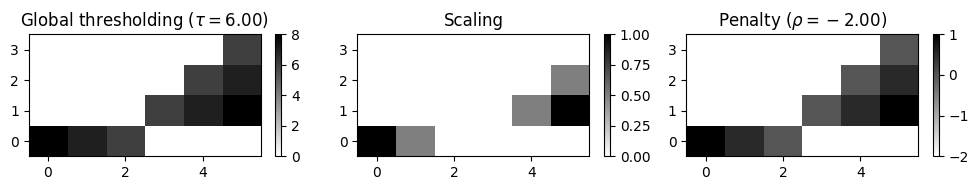

In [38]:
min_value = thresh
max_value = np.max(S_global) 
if max_value > min_value:
    S_scale = np.divide((S_global - min_value), (max_value -  min_value)) 
    S_scale[S_global<thresh] = 0
else:
    raise Exception('Scaling not possible: max > min is violated')    
        
penalty = -2
S_penalty = np.divide((S_global - min_value), (max_value -  min_value)) 
S_penalty[S_global<thresh] = penalty

fig, ax = plt.subplots(1, 3, figsize=(10,2))
plot_matrix(S_global, ax=[ax[0]], xlabel='', ylabel='', 
                     title=r'Global thresholding ($\tau = %0.2f$)'%thresh)
plot_matrix(S_scale, ax=[ax[1]], xlabel='', ylabel='', 
                     title=r'Scaling')
plot_matrix(S_penalty, ax=[ax[2]], xlabel='', ylabel='', 
                     title=r'Penalty ($\rho = %0.2f$)'%penalty)
plt.tight_layout()
plt.show()

## 상대 임계값 (Relative Thresholding)

- 전역 임계값 $\tau$는 **상대적**(relative) 방식으로도 선택할 수 있다. 상대 임계값(relative threshold) 매개변수 $\rho\in [0,1]$가 주어지면 가장 높은 값을 가진 셀의 $\rho\cdot 100\%$를 유지한다. 

- 이를 위해 행렬 항목을 값에 따라 정렬해야 한다. 정렬된 목록에서 $\rho$에 따라 값을 분할하는 전역 임계값을 결정할 수 있다. 이 상대 임계값 전략은 다른 상대 임계값 매개변수를 사용한다.

    - 반올림 문제와 서로 다른 행렬 항목이 동일한 값을 가질 수 있다는 문제 때문에 $\rho$로 지정된 분할이 정확하지 않을 수 있다.

In [39]:
def threshold_matrix_relative(S, thresh_rel=0.2, details=False):
    """Treshold matrix in a relative fashion

    Args:
        S (np.ndarray): Input matrix
        thresh_rel (float): Relative treshold (Default value = 0.2)
        details (bool): Print details on thresholding procedure (Default value = False)

    Returns:
        S_thresh (np.ndarray): Thresholded matrix
        thresh_abs (float): Absolute threshold used for thresholding
    """
    S_thresh = np.copy(S)
    num_cells_below_thresh = int(np.round(S_thresh.size*(1-thresh_rel)))
    values_sorted = np.sort(S_thresh.flatten('F'))
    thresh_abs = values_sorted[num_cells_below_thresh]
    S_thresh[S_thresh < thresh_abs] = 0
    if details:
        print('thresh_rel=%0.2f, thresh_abs=%d, total_num_cells=%d, num_cells_below_thresh=%d, ' %
              (thresh_rel, thresh_abs, S_thresh.size, num_cells_below_thresh))
    return S_thresh, thresh_abs

thresh_rel=0.50, thresh_abs=5, total_num_cells=24, num_cells_below_thresh=12, 
thresh_rel=0.30, thresh_abs=6, total_num_cells=24, num_cells_below_thresh=17, 
thresh_rel=0.10, thresh_abs=8, total_num_cells=24, num_cells_below_thresh=22, 


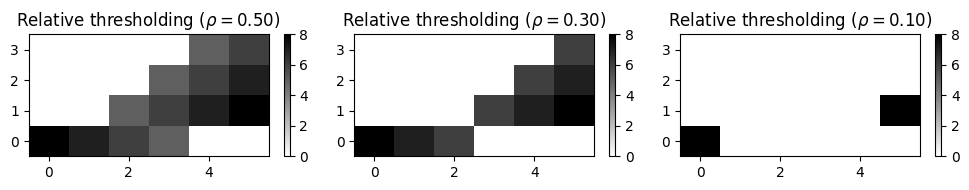

In [40]:
thresh_rel_set = [0.5, 0.3, 0.1]
num = len(thresh_rel_set)
fig, ax = plt.subplots(1, num, figsize=(10,2))
for m in range(num):
    thresh_rel = thresh_rel_set[m]
    S_relative, thresh_abs = threshold_matrix_relative(S, thresh_rel, details=True)
    plot_matrix(S_relative, ax=[ax[m]], xlabel='', ylabel='', 
                         title=r'Relative thresholding ($\rho = %0.2f$)'%thresh_rel)

plt.tight_layout()
plt.show()

## 로컬 임계값 (Local Thresholding)

- 마지막으로, 임계값은 row-wise 및 column-wise으로 임계값을 지정하여 더 많은 **로컬** 전략을 사용하여 수행할 수도 있다. 
- $\rho_1\in[0,1]$를 행(row)의 상대 임계값으로 하고 $\rho_2\in[0,1]$를 열(column)의 상대 임계값으로 설정한다. 
- 각 셀 $(n,m)$에 대해 $\mathbf{S}(n,m)$ 값은 행 $n$에서 가장 큰 셀의 $\rho_1\cdot 100\%$에 있으면 유지된다. 동시에 $m$ 열에서 가장 큰 셀의 $\rho_2\cdot 100\%$ 중에 있으면 다른 모든 값은 0으로 설정된다. 

- 다음 그림에서는 셀이 각각 행 또는 열 중에서 가장 큰지 여부와 최종 결과를 나타내는 두 개의 이진 마스크(binary masks)(중간 결과)를 보여준다.

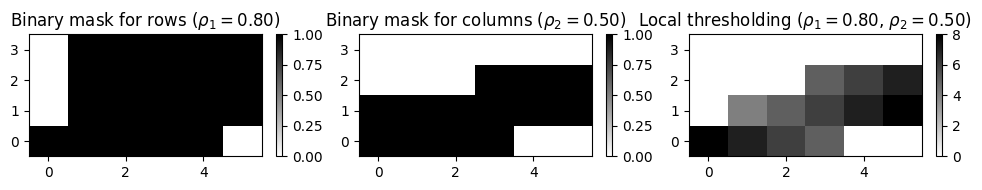

In [41]:
thresh_rel_row=0.8
thresh_rel_col=0.5

S_binary_row = np.ones([N,M])
num_cells_row_below_thresh = int(np.round(M*(1-thresh_rel_row)))
for n in range(N):
    row = S[n,:]
    values_sorted = np.sort(row)
    thresh_abs = values_sorted[num_cells_row_below_thresh]
    S_binary_row[n,:] = (row>=thresh_abs)

S_binary_col = np.ones([N,M])
num_cells_col_below_thresh = int(np.round(N*(1-thresh_rel_col)))  
for m in range(M):
    col = S[:,m]
    values_sorted = np.sort(col)
    thresh_abs = values_sorted[num_cells_col_below_thresh]
    S_binary_col[:,m] = (col>=thresh_abs)
    
S_local =  S * S_binary_row * S_binary_col
    
fig, ax = plt.subplots(1, 3, figsize=(10,2))
plot_matrix(S_binary_row, ax=[ax[0]], xlabel='', ylabel='', 
                     title=r'Binary mask for rows ($\rho_1 = %0.2f$)'%thresh_rel_row)
plot_matrix(S_binary_col, ax=[ax[1]], xlabel='', ylabel='', 
                     title=r'Binary mask for columns ($\rho_2 = %0.2f$)'%thresh_rel_col)
plot_matrix(S_local, ax=[ax[2]], xlabel='', ylabel='', 
                     title=r'Local thresholding ($\rho_1 = %0.2f$, $\rho_2 = %0.2f$)'%(thresh_rel_row,thresh_rel_col))
plt.tight_layout()
plt.show()

## 구현

In [42]:
def threshold_matrix(S, thresh, strategy='absolute', scale=False, penalty=0.0, binarize=False):
    """Treshold matrix in a relative fashion

    Args:
        S (np.ndarray): Input matrix
        thresh (float or list): Treshold (meaning depends on strategy)
        strategy (str): Thresholding strategy ('absolute', 'relative', 'local') (Default value = 'absolute')
        scale (bool): If scale=True, then scaling of positive values to range [0,1] (Default value = False)
        penalty (float): Set values below treshold to value specified (Default value = 0.0)
        binarize (bool): Binarizes final matrix (positive: 1; otherwise: 0) (Default value = False)

    Returns:
        S_thresh (np.ndarray): Thresholded matrix
    """
    if np.min(S) < 0:
        raise Exception('All entries of the input matrix must be nonnegative')

    S_thresh = np.copy(S)
    N, M = S.shape
    num_cells = N * M

    if strategy == 'absolute':
        thresh_abs = thresh
        S_thresh[S_thresh < thresh] = 0

    if strategy == 'relative':
        thresh_rel = thresh
        num_cells_below_thresh = int(np.round(S_thresh.size*(1-thresh_rel)))
        if num_cells_below_thresh < num_cells:
            values_sorted = np.sort(S_thresh.flatten('F'))
            thresh_abs = values_sorted[num_cells_below_thresh]
            S_thresh[S_thresh < thresh_abs] = 0
        else:
            S_thresh = np.zeros([N, M])

    if strategy == 'local':
        thresh_rel_row = thresh[0]
        thresh_rel_col = thresh[1]
        S_binary_row = np.zeros([N, M])
        num_cells_row_below_thresh = int(np.round(M * (1-thresh_rel_row)))
        for n in range(N):
            row = S[n, :]
            values_sorted = np.sort(row)
            if num_cells_row_below_thresh < M:
                thresh_abs = values_sorted[num_cells_row_below_thresh]
                S_binary_row[n, :] = (row >= thresh_abs)
        S_binary_col = np.zeros([N, M])
        num_cells_col_below_thresh = int(np.round(N * (1-thresh_rel_col)))
        for m in range(M):
            col = S[:, m]
            values_sorted = np.sort(col)
            if num_cells_col_below_thresh < N:
                thresh_abs = values_sorted[num_cells_col_below_thresh]
                S_binary_col[:, m] = (col >= thresh_abs)
        S_thresh = S * S_binary_row * S_binary_col

    if scale:
        cell_val_zero = np.where(S_thresh == 0)
        cell_val_pos = np.where(S_thresh > 0)
        if len(cell_val_pos[0]) == 0:
            min_value = 0
        else:
            min_value = np.min(S_thresh[cell_val_pos])
        max_value = np.max(S_thresh)
        # print('min_value = ', min_value, ', max_value = ', max_value)
        if max_value > min_value:
            S_thresh = np.divide((S_thresh - min_value), (max_value - min_value))
            if len(cell_val_zero[0]) > 0:
                S_thresh[cell_val_zero] = penalty
        else:
            print('Condition max_value > min_value is voliated: output zero matrix')

    if binarize:
        S_thresh[S_thresh > 0] = 1
        S_thresh[S_thresh < 0] = 0
    return S_thresh

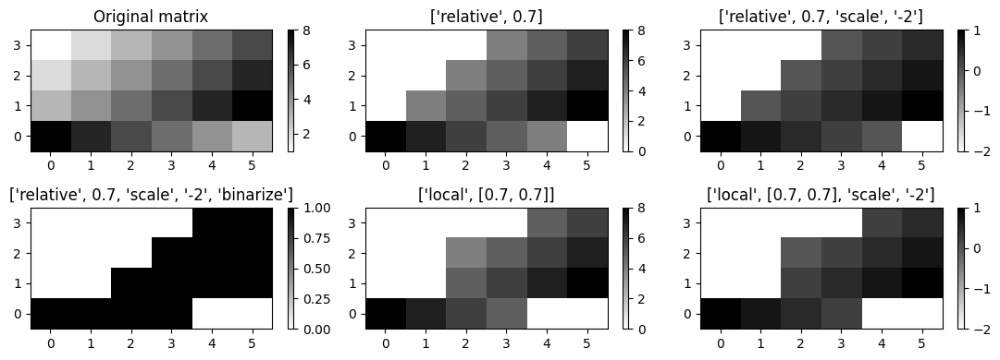

In [43]:
figsize=(11, 4)
fig, ax = plt.subplots(2, 3, figsize=figsize)
plot_matrix(S, ax=[ax[0,0]], xlabel='', ylabel='', title=r'Original matrix')

strategy = 'relative'
thresh = 0.7
S_thresh = threshold_matrix(S, thresh=thresh, strategy=strategy, scale=0, penalty=0, binarize=0)
plot_matrix(S_thresh, ax=[ax[0,1]], xlabel='', ylabel='', 
                     title=[strategy, thresh])

strategy = 'relative'
thresh = 0.7
S_thresh = threshold_matrix(S, thresh=thresh, strategy=strategy, scale=1, penalty=-2, binarize=0)
plot_matrix(S_thresh, ax=[ax[0,2]], xlabel='', ylabel='', 
                     title=[strategy, thresh, "scale", "-2"])

strategy = 'relative'
thresh = 0.7
S_thresh = threshold_matrix(S, thresh=thresh, strategy=strategy, scale=1, penalty=-2, binarize=1)
plot_matrix(S_thresh, ax=[ax[1,0]], xlabel='', ylabel='', 
                     title=[strategy, thresh, "scale", "-2", "binarize"])

strategy = 'local'
thresh = [0.7, 0.7]
S_thresh = threshold_matrix(S, thresh=thresh, strategy=strategy, scale=0, penalty=0, binarize=0)
plot_matrix(S_thresh, ax=[ax[1,1]], xlabel='', ylabel='', 
                     title=[strategy, thresh])

strategy = 'local'
thresh = [0.7, 0.7]
S_thresh = threshold_matrix(S, thresh=thresh, strategy=strategy, scale=1, penalty=-2, binarize=0)
plot_matrix(S_thresh, ax=[ax[1,2]], xlabel='', ylabel='', 
                     title=[strategy, thresh, "scale", "-2"])

plt.tight_layout()
plt.show()

# 예시

In [44]:
def compute_sm_from_filename(fn_wav, L=21, H=5, L_smooth=16, tempo_rel_set=np.array([1]),
                             shift_set=np.array([0]), strategy='relative', scale=True, thresh=0.15,
                             penalty=0.0, binarize=False):
    """Compute an SSM

    Args:
        fn_wav (str): Path and filename of wav file
        L (int): Length of smoothing filter (Default value = 21)
        H (int): Downsampling factor (Default value = 5)
        L_smooth (int): Length of filter (Default value = 16)
        tempo_rel_set (np.ndarray):  Set of relative tempo values (Default value = np.array([1]))
        shift_set (np.ndarray): Set of shift indices (Default value = np.array([0]))
        strategy (str): Thresholding strategy (see :func:`libfmp.c4.c4s2_ssm.compute_sm_ti`)
            (Default value = 'relative')
        scale (bool): If scale=True, then scaling of positive values to range [0,1] (Default value = True)
        thresh (float): Treshold (meaning depends on strategy) (Default value = 0.15)
        penalty (float): Set values below treshold to value specified (Default value = 0.0)
        binarize (bool): Binarizes final matrix (positive: 1; otherwise: 0) (Default value = False)

    Returns:
        x (np.ndarray): Audio signal
        x_duration (float): Duration of audio signal (seconds)
        X (np.ndarray): Feature sequence
        Fs_feature (scalar): Feature rate
        S_thresh (np.ndarray): SSM
        I (np.ndarray): Index matrix
    """
    # Waveform
    x, Fs = librosa.load(fn_wav)
    x_duration = x.shape[0] / Fs

    # Chroma Feature Sequence and SSM (10 Hz)
    C = librosa.feature.chroma_stft(y=x, sr=Fs, tuning=0, norm=2, hop_length=2205, n_fft=4410)
    Fs_C = Fs / 2205

    # Chroma Feature Sequence and SSM
    X, Fs_feature = smooth_downsample_feature_sequence(C, Fs_C, filt_len=L, down_sampling=H)
    X = normalize_feature_sequence(X, norm='2', threshold=0.001)

    # Compute SSM
    S, I = compute_sm_ti(X, X, L=L_smooth, tempo_rel_set=tempo_rel_set, shift_set=shift_set, direction=2)
    S_thresh = threshold_matrix(S, thresh=thresh, strategy=strategy,
                                          scale=scale, penalty=penalty, binarize=binarize)
    return x, x_duration, X, Fs_feature, S_thresh, I

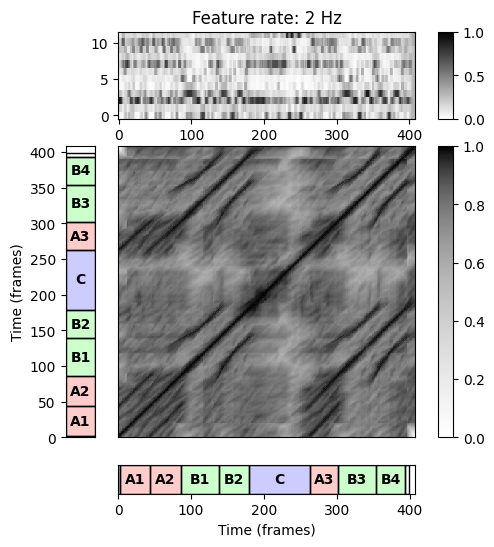

In [48]:
# Annotation
ann, color_ann = read_structure_annotation(fn_ann, fn_ann_color='HungarianDance')

# SM
tempo_rel_set = compute_tempo_rel_set(0.66, 1.5, 5)
x, x_duration, X, Fs_X, S, I = compute_sm_from_filename(fn_wav, L=21, H=5, L_smooth=21, 
                                                        tempo_rel_set=tempo_rel_set, thresh= 1)

# Visualization
ann_frames = convert_structure_annotation(ann, Fs=Fs_X) 
fig, ax = plot_feature_ssm(X, 1, S, 1, ann_frames, x_duration*Fs_X,
            label='Time (frames)', color_ann=color_ann, clim_X=[0,1], clim=[0,1], 
            title='Feature rate: %0.0f Hz'%(Fs_X))

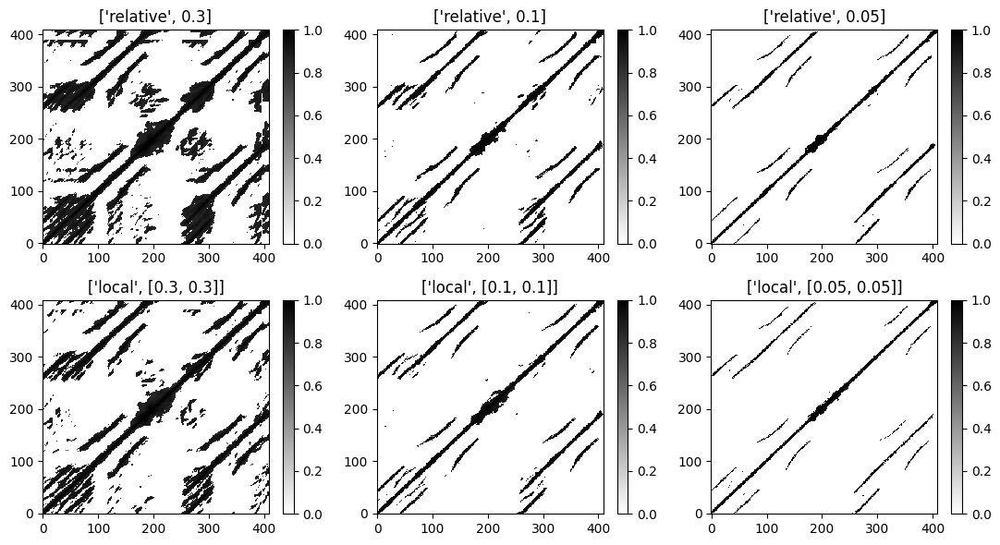

In [49]:
figsize=(11,6)

thresh_set = [0.3, 0.1, 0.05]
strategy_set = ['relative', 'local']
num_t = len(thresh_set)
num_s = len(strategy_set)
fig, ax = plt.subplots(num_s, num_t, figsize=figsize)
for s in range(num_s):
    for t in range(num_t):
        thresh = thresh_set[t]
        strategy = strategy_set[s]
        if strategy == 'local':
            thresh = [thresh, thresh]
        S_thresh = threshold_matrix(S, thresh=thresh, strategy=strategy)
        plot_matrix(S_thresh, ax=[ax[s,t]], xlabel='', ylabel='', 
                             title=[strategy, thresh])
plt.tight_layout()
plt.show()

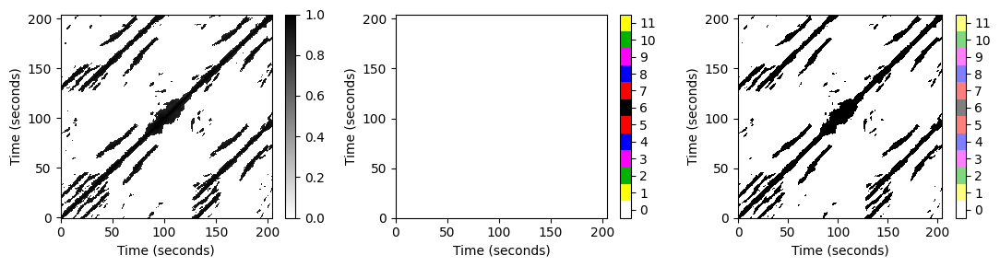

In [50]:
S_thresh = threshold_matrix(S, thresh=[0.2,0.2], strategy='local')

figsize=(11,3)
fig, ax = plt.subplots(1, 3, figsize=figsize)
plot_matrix(S_thresh, ax=[ax[0]], Fs=Fs_X, Fs_F=Fs_X, ylabel='Time (seconds)')

subplot_matrix_ti_colorbar(I, fig, Fs=Fs_X, ax=ax[1], ind_zero=True)

im = subplot_matrix_ti_colorbar(I, fig, ax=ax[2], ind_zero=True, Fs=Fs_X, alpha=0.5)
colorList = np.array([[1,1,1,0],[0,0,0,1]])
cmap = ListedColormap(colorList)  
plt.imshow(S_thresh, cmap=cmap, origin = 'lower', 
           extent=[0, S_thresh.shape[0]/Fs_X, 0, S_thresh.shape[0]/Fs_X])
plt.tight_layout()
plt.show()

**다른 예: Zager Evans - In The Year 2525**

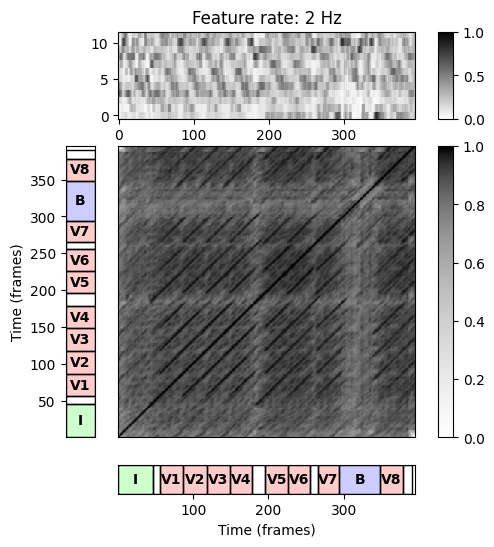

In [59]:
# Annotation
fn_ann = '../data_FMP/FMP_C4_F13_ZagerEvans_InTheYear2525.csv'
ann, color_ann = read_structure_annotation(fn_ann, fn_ann_color='InTheYear2525')

# SM
fn_wav =  '../data_FMP/FMP_C4_F13_ZagerEvans_InTheYear2525.wav'
shift_set = np.array(range(12))
x, x_duration, X, Fs_X, S, I = compute_sm_from_filename(fn_wav, L=21, H=5, L_smooth=11, 
                                                       shift_set=shift_set, thresh= 1)
# Visualization
ann_frames = convert_structure_annotation(ann, Fs=Fs_X) 
fig, ax = plot_feature_ssm(X, 1, S, 1, ann_frames, x_duration*Fs_X,
            label='Time (frames)', color_ann=color_ann, clim_X=[0,1], clim=[0,1], 
            title='Feature rate: %0.0f Hz'%(Fs_X))

In [52]:
ipd.Audio(fn_wav)

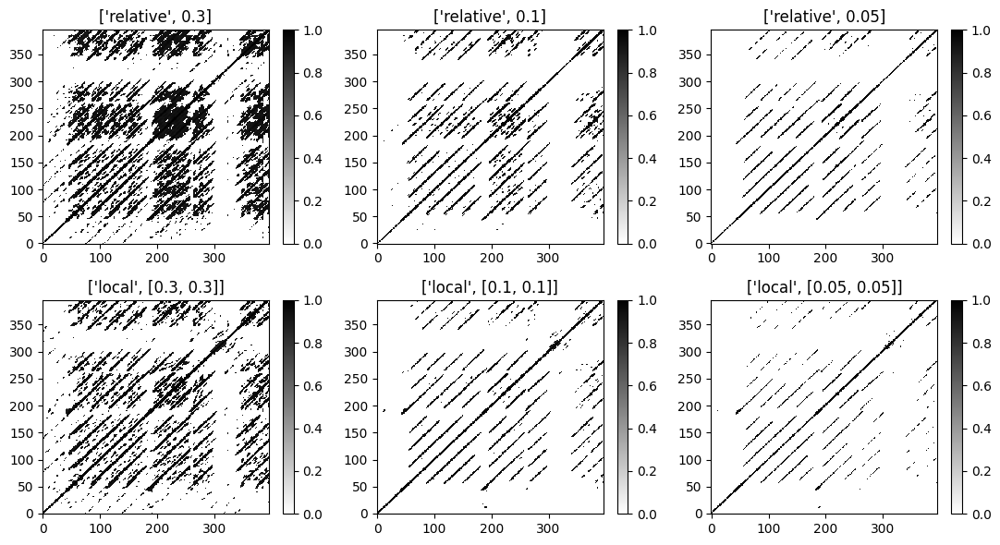

In [54]:
figsize=(11,6)

thresh_set = [0.3, 0.1, 0.05]
strategy_set = ['relative', 'local']
num_t = len(thresh_set)
num_s = len(strategy_set)
fig, ax = plt.subplots(num_s, num_t, figsize=figsize)
for s in range(num_s):
    for t in range(num_t):
        thresh = thresh_set[t]
        strategy = strategy_set[s]
        if strategy == 'local':
            thresh = [thresh, thresh]
        S_thresh = threshold_matrix(S, thresh=thresh, strategy=strategy)
        plot_matrix(S_thresh, ax=[ax[s,t]], xlabel='', ylabel='', 
                             title=[strategy, thresh])
plt.tight_layout()
plt.show()

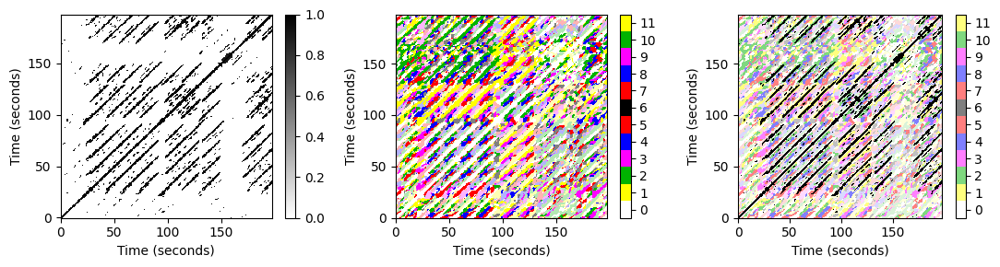

In [57]:
S_thresh = threshold_matrix(S, thresh=[0.2,0.2], strategy='local')

figsize=(11,3)
fig, ax = plt.subplots(1, 3, figsize=figsize)
plot_matrix(S_thresh, ax=[ax[0]], Fs=Fs_X, Fs_F=Fs_X, ylabel='Time (seconds)')

subplot_matrix_ti_colorbar(I, fig, Fs=Fs_X, ax=ax[1], ind_zero=True)

im = subplot_matrix_ti_colorbar(I, fig, ax=ax[2], ind_zero=True, Fs=Fs_X, alpha=0.5)
colorList = np.array([[1,1,1,0],[0,0,0,1]])
cmap = ListedColormap(colorList)  
plt.imshow(S_thresh, cmap=cmap, origin = 'lower', 
           extent=[0, S_thresh.shape[0]/Fs_X, 0, S_thresh.shape[0]/Fs_X])
plt.tight_layout()
plt.show()      

---

출처: 

- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C4/C4S2_SSM.html
- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C4/C4S2_SSM-Synthetic.html
- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C4/C4S2_SSM-FeatureSmoothing.html
- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C4/C4S2_SSM-PathEnhancement.html
- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C4/C4S2_SSM-TranspositionInvariance.html
- https://www.audiolabs-erlangen.de/resources/MIR/FMP/C4/C4S2_SSM-Thresholding.html


---

[구글 Colab 링크](https://colab.research.google.com/github/jo-cho/mir_kr/blob/main/Notebooks/5.%20Music%20Structure%20Analysis/5.2.Self_Similarity_Matrix.ipynb)

---

<a href="https://jo-cho.github.io/MIRBlog/posts/5.%20Music%20Structure%20Analysis/5.1.Music_Structure_and_Segmentation.html"> $\leftarrow$ 5.1. 음악 구조와 분할
<div style="text-align: right"> <a href="https://jo-cho.github.io/MIRBlog/posts/5.%20Music%20Structure%20Analysis/5.3.Audio_Thumbnail.html"> 5.3. 오디오 썸네일 $\rightarrow$ </a> </div>